# Cell type deconvolution analysis with cell2location - single-organ mapping

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os,sys
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import scipy.sparse
import anndata

In [3]:
figdir = "/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/spatial_mapping_EDA/"
if os.path.exists(figdir):
    sc.settings.figdir = figdir
else:
    os.mkdir(figdir)
    sc.settings.figdir = figdir
    

In [4]:
# ## Directory to save intermediate outputs
# writedir = "/nfs/team205/ed6/data/Fetal_immune/PAGA_FA_outs/"
# if not os.path.exists(writedir):
#     os.mkdir(writedir)    

In [5]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

In [6]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

Activate the anndata2ri conversion between SingleCellExperiment and AnnData

In [7]:
anndata2ri.activate()

In [8]:
%load_ext rpy2.ipython

In [9]:
%%R
library(tidyverse)

### Plotting utils

In [10]:
%%R
library(tidyverse)
library(reshape2)
library(patchwork)

remove_x_axis <- function(){
  theme(axis.text.x = element_blank(), axis.ticks.x = element_blank(), axis.title.x = element_blank())  
}

remove_y_axis <- function(){
  theme(axis.text.y = element_blank(), axis.ticks.y = element_blank(), axis.title.y = element_blank())  
}

In [11]:
# pip install matplotlib-scalebar
from matplotlib_scalebar.scalebar import ScaleBar

def get_pixel_size_visium(adata, library_id, spot_diameter_real = 55, img='lowres'):
    '''
    Utility function to get size of pixels from visium image in AnnData.
    Useful to plot scalebars with matplotlib_scalebar.ScaleBar
    
    Params:
    -------
    - adata: AnnData object storing image info in adata.uns[spatial]
    - library_id: string storing ID for image, must be a key in adata.uns[spatial]
    - spot_diameter_real: numeric storing real diameter of spot, in whatever unit you need 
        (default is 55, for 55 microns of Visium 10X spots)
    - img: which image to use (default: lowres)
    '''

    ## get scale factor converting original pixel positions (adata.obsm['spatial']) to 
    # pixel positions in image
    scalef = adata.uns['spatial'][library_id]['scalefactors']['tissue_{i}_scalef'.format(i=img)]
    ## get spot diameter in image pixels
    spot_diameter_img = adata.uns['spatial'][library_id]['scalefactors']['spot_diameter_fullres'] * scalef
    ## Calculate pixel size
    pixel_size_real = spot_diameter_real/spot_diameter_img
    return(pixel_size_real)


In [12]:
def _spatial_plot_lib(adata_vis, lib, color_by=None, **kwargs):
    with matplotlib.rc_context({"axes.facecolor": "black"}):
        s_ind = adata_vis.obs['sample'] == lib
        s_keys = list(adata_vis.uns['spatial'].keys())
        s_spatial = np.array(s_keys)[[lib in i for i in s_keys]][0]
        adata_small = adata_vis[s_ind, :].copy()
        sc.pl.spatial(adata_small, library_id=s_spatial,
                                **kwargs)
        
def _plot_sorted_violin(merged_adata_bcells, groupby, y_value, return_list=False):
    n_cells_anno = merged_adata_bcells.obs[[groupby,y_value]].value_counts(groupby)
    keep_anno = n_cells_anno.index[n_cells_anno > 30]

    mean_sim = merged_adata_bcells.obs[[groupby,y_value]].groupby(groupby).mean()
    anno_order = mean_sim.loc[keep_anno].sort_values(y_value, ascending=False).index.tolist()

    merged_adata_bcells.var_names_make_unique()
    sc.pl.violin(merged_adata_bcells[merged_adata_bcells.obs[groupby].isin(keep_anno)], 
                                     y_value, groupby=groupby, rotation=90, 
                                     order=anno_order)
    if return_list:
        return(anno_order)
    

In [13]:
def select_slide(adata, s, s_col='sample'):
    r""" This function selects the data for one slide from the spatial anndata object.
    
    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param s_col: column in adata.obs listing experiment name for each location
    """
    
    slide = adata[adata.obs[s_col].isin([s]), :].copy()
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}
    
    return slide

def plot_spatial_per_cell_type(adata, 
                                   cell_type='total_counts',
                                   samples=['WSSS_F_IMMsp9838712', 'WSSS_F_IMMsp9838717', 
                                             'WSSS_F_IMMsp9838710', 
                                             'WSSS_F_IMMsp9838715', 
                                            'WSSS_F_IMMsp9838711', 'WSSS_F_IMMsp9838716'],
                               cmap='magma',
                                  ncol=3, prefix='', figsize=(18, 8), **kwargs):
        n_samples = len(samples)
        nrow = int(np.ceil(n_samples / ncol))
        fig, axs = plt.subplots(nrow, ncol, figsize=figsize)
        if nrow == 1:
            axs = axs.reshape((1, ncol))
        if cell_type:
            col_name = f'{prefix}{cell_type}'
            vmax = np.quantile(adata[adata.obs["sample"].isin(samples)].obs[col_name].values, 0.992)
            adata.obs[cell_type] = adata.obs[col_name].copy()

        from itertools import chain
        ind = list(chain(*[[(i, j) for i in range(nrow)] for j in range(ncol)]))

        for i, s in enumerate(samples):
            sp_data_s = select_slide(adata, s, s_col='sample')
            lib_id = [x for x in sp_data_s.uns['spatial'].keys()][0]
            pix_size = get_pixel_size_visium(sp_data_s, lib_id, img='hires')
            if cell_type:
                sc.pl.spatial(sp_data_s, cmap=cmap,
                              color=cell_type, 
                              size=1, img_key='hires', alpha_img=1,
                              vmin=0, vmax=vmax, ax=axs[ind[i][0],ind[i][1]], show=False, **kwargs
                                                )
                axs[ind[i][0],ind[i][1]].title.set_text(cell_type+'\n'+s)
                scalebar = ScaleBar(pix_size, "um", length_fraction=0.25, frameon=False, location='lower right')
                axs[ind[i][0],ind[i][1]].add_artist(scalebar)
            else: 
                sc.pl.spatial(sp_data_s,
                              color=cell_type, 
                              size=1, img_key='hires', alpha_img=1,
                              ax=axs[ind[i][0],ind[i][1]], show=False, **kwargs)
                axs[ind[i][0],ind[i][1]].title.set_text(s)
                scalebar = ScaleBar(pix_size, "um", length_fraction=0.25, frameon=False, location='lower right')
                axs[ind[i][0],ind[i][1]].add_artist(scalebar)
        fig.tight_layout(pad=0.5)

        return fig

In [14]:
def plot_w_ggplot(r_fct_str, args, figdir, pl_name='plot', pl_width=8, pl_height=8):

    import rpy2.robjects.pandas2ri
    import rpy2.robjects.numpy2ri
    from rpy2.robjects.packages import STAP

    r_pkg = STAP(r_fct_str, "r_pkg")
    
    # PASS OBJECTS INTO FUNCTION
    pl = r_pkg.plot_func(args)
    
    ggsave_str = '''
    save_plot <- function(pl, figdir, pl_name, pl_width, pl_height){
        pl + 
        ggsave(paste0(figdir, pl_name, ".png"), width=pl_width, height=pl_height)  +
        ggsave(paste0(figdir, pl_name, ".pdf"), width=pl_width, height=pl_height)
    }
    
    '''
    r_save = STAP(ggsave_str, "r_save")
    r_save.save_plot(pl, figdir, pl_name=pl_name, pl_width=pl_width, pl_height=pl_height)
    

In [15]:
select_slides = {
    'SP':['WSSS_F_IMMsp9838710', 'WSSS_F_IMMsp9838715'],
    "LI":['WSSS_F_IMMsp9838712', 'WSSS_F_IMMsp9838717'],
    "TH":['WSSS_F_IMMsp9838716', 'WSSS_F_IMMsp9838711'],
    }

def _plot_slides_spatial(adata_vis_full, 
                         col_name, 
                         samples = sum(select_slides.values(), []), 
                         ncol=4, vmin=0):
    n_samples = len(samples)
    nrow = int(np.ceil(n_samples / ncol))
    fig, axs = plt.subplots(nrow, ncol, figsize=(18, 8))
    if nrow == 1:
        axs = axs.reshape((1, ncol))

    from itertools import chain
    ind = list(chain(*[[(i, j) for i in range(nrow)] for j in range(ncol)]))

    for i, s in enumerate(samples):
        vmax = np.quantile(adata_vis_full[adata_vis_full.obs["sample"].isin([s])].obs[col_name].values, 0.992)
        sns.set_context("notebook", font_scale=1.1)
        plt.rcParams["figure.figsize"] = [10,10]
        plt.rcParams['axes.titlesize'] = 32
        _spatial_plot_lib(adata_vis_full, color=[col_name], lib=s, ncols=1, size=1.3, vmin=vmin, vmax=vmax,
                          cmap="magma", frameon=False, title="",
                          ax=axs[ind[i][0],ind[i][1]], show=False
                         )
        plt.locator_params(axis='y', nbins=3)
        plt.rcParams['axes.titlesize'] = 20

    fig.tight_layout()
    return(fig)

In [16]:
%%R
library(patchwork)

plot_factor_id <- function(nmf_fractions, f, min_frac= 0.1, n_top=NULL, basesize=16,
                           highlight_cts = NULL
                          ){
    highlight_color = 'red'
    nmf_frac_df <- nmf_fractions %>%
        rownames_to_column('celltype') %>%
         pivot_longer(cols=-celltype, names_to="factor") %>%
        mutate(factor=str_remove(factor, 'mean_cell_type_factors')) 
    nmf_frac_df <- nmf_frac_df %>%
     filter(factor==paste0('fact_',f)) %>%
        filter(value > min_frac) %>%
        arrange(value) %>%
        mutate(celltype=factor(celltype, levels=celltype))
    
    if (!is.null(n_top)){
        nmf_frac_df <- nmf_frac_df %>%
        top_n(n_top, value)
    }
    
    if (!is.null(highlight_cts)){
       nmf_frac_df <- nmf_frac_df %>%
        mutate(ct_highlight=celltype %in% highlight_cts)
        label_colors <- ifelse(nmf_frac_df$celltype %in% highlight_cts, highlight_color,'black')
        label_facefont <- ifelse(nmf_frac_df$celltype %in% highlight_cts, 'bold','plain')
    }
    
    
    pl <- nmf_frac_df %>%
        ggplot(aes(value, celltype)) +
        geom_point(size=5) +
        geom_col(color='black', width=0.01) +
        theme_bw(base_size=basesize) +
        xlab("celltype fraction") +
        ggtitle(paste0("Factor", f))
    
    if (!is.null(highlight_cts)){
       pl <- pl +
        geom_point(data=. %>% filter(ct_highlight), size=6, color=highlight_color) +
        geom_col(data=. %>% filter(ct_highlight), color=highlight_color, width=0.02) +
        theme(axis.text.y = element_text(colour = label_colors, face=label_facefont))
    }
    
    return(pl)
    }

In [17]:
org_colors = pd.read_csv('../../metadata/organ_colors.csv')
org_colors

,organ,color
0,YS,#0173b2
1,LI,#de8f05
2,BM,#029e73
3,TH,#d55e00
4,SP,#cc78bc
5,MLN,#ca9161
6,SK,#fbafe4
7,GU,#949494
8,KI,#ece133


### Load scRNA-seq cell numbers
used for further filtering

In [18]:
## Filter maternal contaminants
data_dir = '/nfs/team205/ed6/data/Fetal_immune/'
timestamp = '20210429'
mat_barcodes = pd.read_csv("~/Pan_fetal_immune/metadata/souporcell_results/maternal_barcodes.csv", index_col=0)
mat_barcodes["x"] = pd.Series([x.split("-1")[0] for x in mat_barcodes['x']])
anno_obs = pd.read_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [19]:
## Abundance in sc data
sc_ct_donor_counts = anno_obs[anno_obs.organ.isin(["TH", "LI", "SP", "GU"])].groupby(['organ','anno_lvl_2_final_clean', 'donor']).count().unstack(fill_value=0).stack()
sc_ct_donor_counts = sc_ct_donor_counts.reset_index()[['organ','anno_lvl_2_final_clean','donor', 'n_genes']]
sc_ct_donor_counts.columns = ['organ','anno_lvl_2_final_clean','donor','n_cells']

In [20]:
%%R -i sc_ct_donor_counts -o ct_donor_filter
ct_donor_filter <- sc_ct_donor_counts %>%
    group_by(organ, anno_lvl_2_final_clean) %>%
    summarise(donor_pass=sum(n_cells > 10) >= 3) %>%
    ungroup() %>%
    filter(donor_pass) %>%
    select(organ, anno_lvl_2_final_clean)

`summarise()` has grouped output by 'organ'. You can override using the `.groups` argument.


In [21]:
def ct_donor_pass_filter(ct, org):
    return(ct in ct_donor_filter[ct_donor_filter.organ == org]['anno_lvl_2_final_clean'].values)

In [22]:
ct_donor_pass_filter('CD8AA', "SP")

True

### Read results

In [25]:
def read_c2l(c2l_outdir, skip_organ=False):
    adata_vis = sc.read_h5ad(c2l_outdir + "sp.h5ad")
    if not skip_organ:
        adata_vis.obs["Organ"] = adata_vis.obs["Organ"].str[0:2]

    ## Add total cell abundance
    adata_vis.obs['total_cell_abundance'] = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1).flatten()

    # add 5% quantile, representing confident cell abundance, 'at least this amount is present', 
    # to adata.obs with nice names for plotting
    # adata_vis.obs[adata_vis.uns['mod']['factor_names']] = (adata_vis.obsm['q05_cell_abundance_w_sf'].T/adata_vis.obs["total_cell_abundance"]).T
    adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf'].copy()

    ## Make metadata table for libraries
    vis_sample_metadata = adata_vis.obs[["sample", 'Organ', "Age_PCW", "Fetal_id"]].drop_duplicates()
    vis_sample_metadata.index = vis_sample_metadata['sample'].copy()
    vis_sample_metadata = vis_sample_metadata.drop("sample", 1)

    ## Ref celltypes info
    celltypes_df = pd.DataFrame(adata_vis.uns['mod']['factor_names'], columns=['annotation'])
    celltypes_df['anno_group'] = [anno_groups_dict_rev[c] if c in anno_groups_dict_rev.keys() else "STROMAL" for c in celltypes_df.annotation]
    celltypes_df['stromal_organ'] = np.nan
    celltypes_df.loc[celltypes_df['anno_group'] == "STROMAL", "stromal_organ"] = [x[-1] for x in celltypes_df[celltypes_df['anno_group'] == "STROMAL"].annotation.str.split("_")]

    celltypes_df.index = celltypes_df['annotation'].copy()
    return(adata_vis, celltypes_df, vis_sample_metadata)

In [26]:
## Read annotation groupings
import json
with open('../../metadata/anno_groups.json', 'r') as json_file:
    anno_groups_dict = json.load(json_file)
anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}
anno_groups_dict_rev = {"_".join(k.split("/")):v for k,v in anno_groups_dict_rev.items()}

In [85]:
organs = ['SP', "LI", "TH"]
c2l_outdirs = [
        '/warehouse/cellgeni/tic-1349/prediction/alpha20/tic-1451/subsetSP/predmodel/',
        '/warehouse/cellgeni/tic-1349/prediction/alpha20/tic-1468/subsetLI/predmodel/',
        '/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/results/spatial_mapping_TH_fetal_TECs_revisedTissuefilter_v2annot_epochs50k_alphatest20/'
    ]

# ids = ['SP_revisedTissueFilter_v2annot', "LI_v2annot_revisedTissuefilter", 'TH_fetal_TECs_revisedTissuefilter_v2annot']
# c2l_outdirs = [c2l_results_dir + 'spatial_mapping_{i}_epochs50k_alphatest20/'.format(i=ids[i]) for i in range(len(ids))]

res_ls = [read_c2l(outdir) for outdir in c2l_outdirs]    

c2l_results = {organs[i]:res_ls[i][0] for i in range(len(res_ls))}

In [86]:
vis_sample_metadata = pd.concat([res_ls[i][2] for i in range(len(res_ls))], ignore_index=True)
vis_sample_metadata.index = np.concatenate([res_ls[i][2].index.astype("str") for i in range(len(res_ls))])
vis_sample_metadata.Organ = vis_sample_metadata.Organ.str.upper()

In [87]:
vis_sample_metadata

,Organ,Age_PCW,Fetal_id
WSSS_F_IMMsp9838710,SP,18,F121
WSSS_F_IMMsp9838715,SP,18,F121
WSSS_F_IMMsp10864181,SP,18,F136
WSSS_F_IMMsp10864182,SP,18,F136
WSSS_F_IMMsp9838712,LI,18,F121
WSSS_F_IMMsp9838717,LI,18,F121
WSSS_F_IMMsp10864184,LI,18,F136
WSSS_F_IMMsp9838711,TH,18,F121
WSSS_F_IMMsp9838716,TH,18,F121
WSSS_F_IMMsp10864183,TH,18,F136


In [96]:
## Filter out isolated spots from plotting
for o in c2l_results.keys():
    c2l_results[o].obs['tot_spatial_neighbors'] = np.nan
    for s in c2l_results[o].obs['sample'].unique():
        sdata = select_slide(c2l_results[o], s)
        sq.gr.spatial_neighbors(sdata, n_rings=1, coord_type="grid", n_neighs=6)
        spatial_nns = sdata.obsp['spatial_connectivities']
        c2l_results[o].obs.loc[sdata.obs_names, 'tot_spatial_neighbors'] = np.array(spatial_nns.sum(0)).ravel()
    c2l_results[o] = c2l_results[o][c2l_results[o].obs['tot_spatial_neighbors'] > 1].copy()

### QC plots

... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical


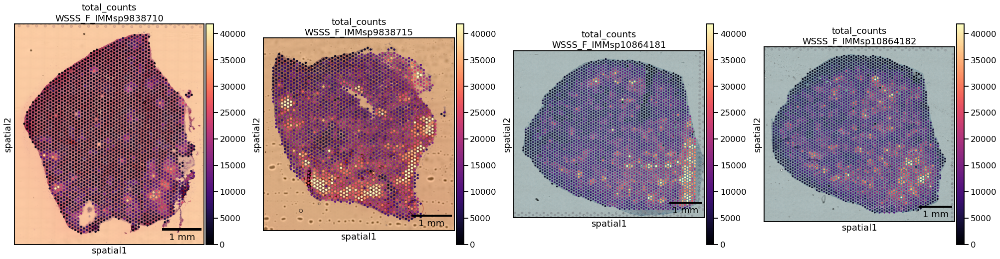

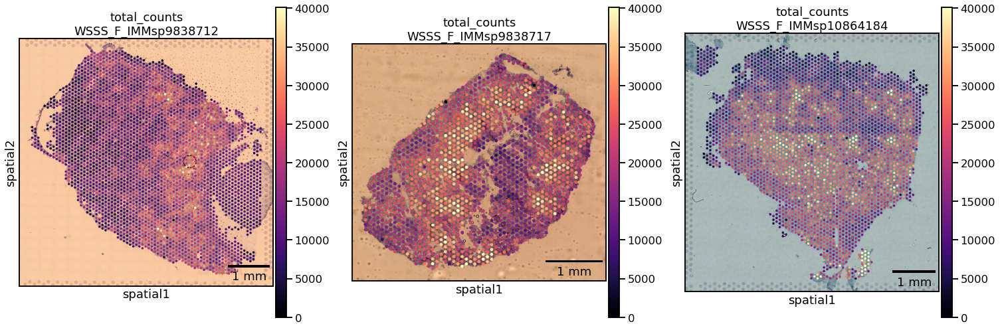

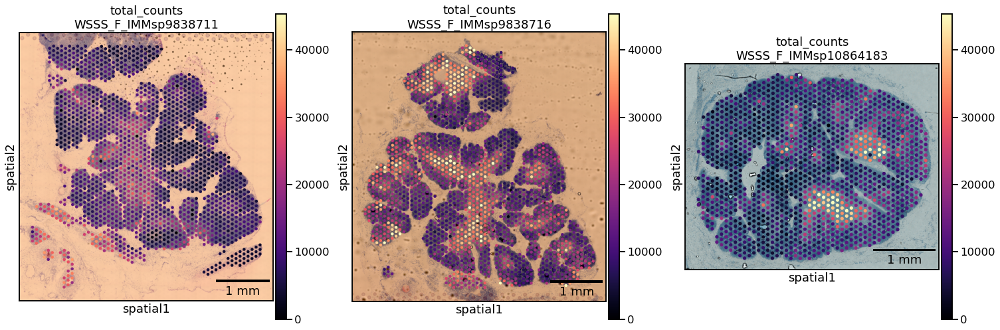

In [97]:
plt.rcParams['axes.titlesize'] = 18
for org in ['SP', "LI", 'TH']:
    n_samples = c2l_results[org].obs["sample"].unique().shape[0]
    fig = plot_spatial_per_cell_type(c2l_results[org], cell_type='total_counts', 
                            samples=c2l_results[org].obs["sample"].unique(), 
                            ncol=n_samples, figsize=[7*n_samples, 7])
    fig.savefig(figdir + '_total_counts_{o}.pdf'.format(o=org))

... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical


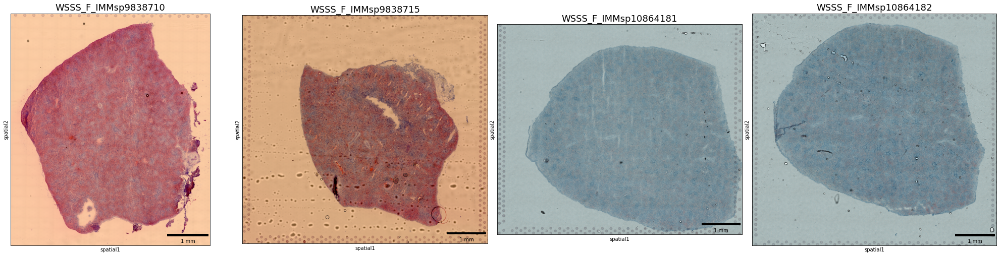

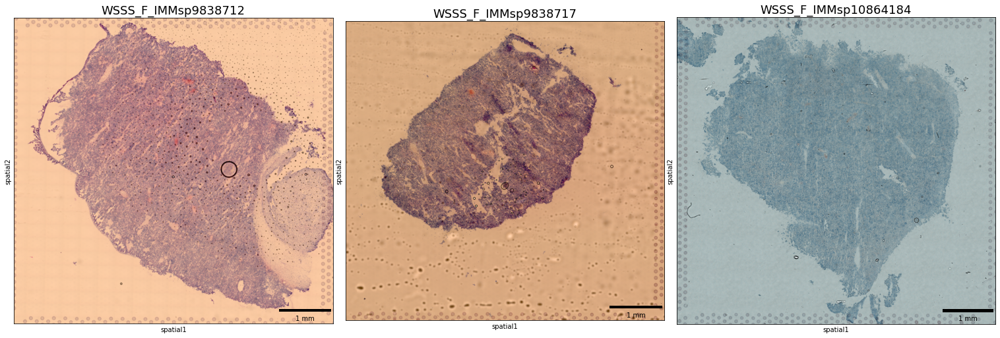

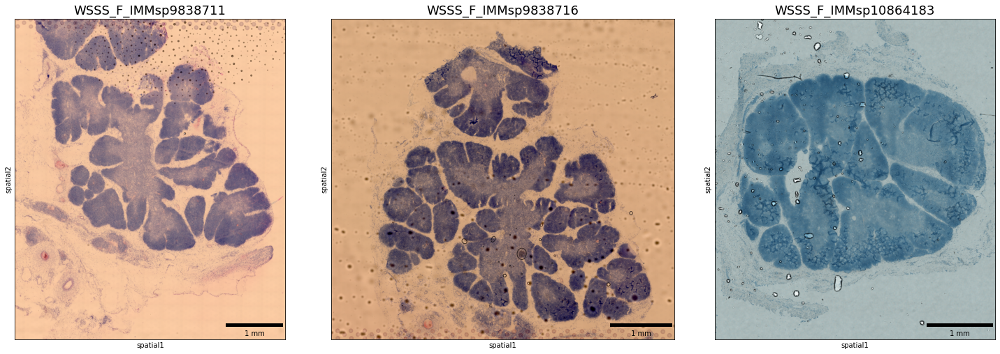

In [32]:
plt.rcParams['axes.titlesize'] = 18
for org in ['SP', "LI", 'TH']:
    n_samples = c2l_results[org].obs["sample"].unique().shape[0]
    fig = plot_spatial_per_cell_type(c2l_results[org], cell_type=None, 
                            samples=c2l_results[org].obs["sample"].unique(), 
                            ncol=n_samples, figsize=[7*n_samples, 7])
    fig.savefig(figdir + '_hne_{o}.pdf'.format(o=org))

### Check robustness of celltype abundances across biological replicates

In [49]:
plot_str = '''
plot_replicate_scatter <- function(replicate_comparison_df, sample_pair){
    pl <- replicate_comparison_df %>%
        rename(sample1=sample_pair[1], sample2=sample_pair[2]) %>%
        ggplot(aes(log10(sample1), log10(sample2))) +
        geom_point(color='cadetblue') +
        ggpubr::stat_cor(size = 5) +
        xlab(paste0("log10(abundance)\n", sample_pair[1])) +
        ylab(paste0("log10(abundance)\n", sample_pair[2])) +
        theme_bw(base_size=18) +
        coord_fixed()
    pl
    }

plot_func <- function(org_ct_counts){
    replicate_comparison_df <- org_ct_counts %>%
        select(sample, sum_cell_abundance, anno_lvl_2_final_clean) %>%
        pivot_wider(names_from='sample', values_from='sum_cell_abundance') 

    all_pairs <- combn(unique(org_ct_counts$sample), 2)
    # org_ct_counts
    pl_ls <- lapply(1:ncol(all_pairs), function(i) plot_replicate_scatter(replicate_comparison_df, all_pairs[,i]))
    wrap_plots(pl_ls, nrow=1)
    }
'''

In [50]:
# vis_ct_counts = 
for i,o in enumerate(organs):
    org_ct_counts = c2l_results[o].obs[res_ls[i][1].annotation.tolist() + ["sample"]].groupby("sample").sum()
    org_ct_counts = org_ct_counts[org_ct_counts.index.isin(vis_sample_metadata.index)]
    org_ct_counts = org_ct_counts.reset_index().melt(id_vars=["sample"], var_name="anno_lvl_2_final_clean", value_name="sum_cell_abundance")

    org_total_abundance = c2l_results[o].obs[['sample','total_cell_abundance']].groupby('sample').sum('total_cell_abundance').reset_index()
    org_total_abundance.columns=['sample', 'total_cell_abundance']
    org_ct_counts = pd.merge(org_ct_counts, org_total_abundance, how='left')
    org_ct_counts['rel_cell_abundance'] = org_ct_counts['sum_cell_abundance']/org_ct_counts['total_cell_abundance']
    org_ct_counts['sample'] = org_ct_counts['sample'].astype("str")
    
    plot_w_ggplot(plot_str, org_ct_counts, figdir, pl_name='{o}_replicate_correlation'.format(o=o), 
                  pl_width=6*len(org_ct_counts['sample'].unique()), pl_height=5)

In [ ]:
# ### Check that abundance after deconvolution correlates with abundance in single-cell data

# ## Filter maternal contaminants
# data_dir = '/nfs/team205/ed6/data/Fetal_immune/'
# timestamp = '20210429'
# mat_barcodes = pd.read_csv("~/Pan_fetal_immune/metadata/souporcell_results/maternal_barcodes.csv", index_col=0)
# mat_barcodes["x"] = pd.Series([x.split("-1")[0] for x in mat_barcodes['x']])
# anno_obs = pd.read_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)

# ## Abundance in sc data
# sc_ct_counts = anno_obs[anno_obs.age >= 16][anno_obs[anno_obs.age >= 16].organ.isin(organs)].groupby(['organ','anno_lvl_2_final_clean']).count().unstack(fill_value=0).stack()
# sc_ct_counts = sc_ct_counts.reset_index()[['organ','anno_lvl_2_final_clean','n_genes']]
# sc_ct_counts.columns = ['organ','anno_lvl_2_final_clean','n_cells']

# ## Abundance in visium deconvolution
# all_counts = pd.DataFrame()
# for i,o in enumerate(organs):
#     vis_ct_counts = c2l_results[o].obs[res_ls[i][1].annotation.tolist() + ["Organ"]].groupby("Organ").sum()
#     vis_ct_counts = vis_ct_counts.reset_index().melt(id_vars=["Organ"], var_name="anno_lvl_2_final_clean", value_name="sum_cell_abundance")
#     vis_ct_counts.columns = ['organ'] + list(vis_ct_counts.columns[1:])

#     ## Calculate relative abundance over total cell abundance per organ
#     org_total_abundance = c2l_results[o].obs[['Organ','total_cell_abundance']].groupby('Organ').sum('total_cell_abundance').reset_index()
#     org_total_abundance.columns=['organ', 'total_cell_abundance']
#     vis_ct_counts = pd.merge(vis_ct_counts, org_total_abundance, how='left')
#     vis_ct_counts['rel_cell_abundance'] = vis_ct_counts['sum_cell_abundance']/vis_ct_counts['total_cell_abundance']

#     all_counts_org = pd.merge(vis_ct_counts, sc_ct_counts)
#     all_counts = pd.concat([all_counts, all_counts_org])

# c2l_results['SP'].obs[res_ls[i][1].annotation.tolist() + ["Organ"]].groupby("Organ").sum()

# all_counts.to_csv('/nfs/team205/ed6/data/Fetal_immune/spatial_analysis_outs/spatial_abundance_VS_ncells.csv')

# %%R -i all_counts -w 1000 -h 700 -i figdir
# pl <- all_counts %>%
# #     filter(mean_cell_abundance > 0.1) %>%
#     ggplot(aes(log10(sum_cell_abundance), log10(n_cells))) +
#     geom_point(size=3, alpha=0.5) +
#     facet_wrap(organ~.) +
# #     geom_smooth(method='lm') +
#     ggpubr::stat_cor(size=6) +
#     theme_bw(base_size = 18) +
#     xlab("log10(relative spatial abundance)") + ylab("log10(# scRNA-seq cells @ 17PCW)") 
    
# ggsave(paste0(figdir, 'cell_abundance_comparison.pdf'),pl, width=15, height=5)
# pl    

In [561]:
# all_counts['prog_group'] = [progenitor_groups_rev[x] if x in progenitor_groups_rev.keys() else np.nan for x in all_counts['anno_lvl_2_final_clean']]
# all_counts['prog_group'] = all_counts.prog_group.astype("str")

# %%R -i all_counts -w 1000 -h 700 -i figdir
# lineage_names <- list(
#   'MEM_prog'="Megakaryocyte/Erythroid\nprogenitors",
#   'MYE_prog'="Myeloid\nprogenitors",
#   'B_prog'="B cells\nprogenitors",
#   'T_prog'="T cells\nprogenitors"
# )


# pl2 <- all_counts %>%
#     ggplot(aes(sum_cell_abundance, n_cells+1)) +
#     scale_y_log10() + scale_x_log10() +
#     geom_point(size=2, alpha=0.5) +
#     geom_point(data= . %>% filter(prog_group!="nan"), aes(fill=prog_group), size=3, shape=21) +
#     facet_wrap(organ~., scale='free') +
# #     geom_smooth(method='lm') +
#     scale_fill_brewer(palette="Accent",
#                       labels=lineage_names,
#                       name='Progenitor\nlineage') +
#     guides(fill=guide_legend(keyheight=3, override.aes=list(size=5))) +
#     ggpubr::stat_cor(size=6) +
#     theme_bw(base_size = 18) +
#     xlab("log10(relative spatial abundance)") + ylab("log10(# scRNA-seq cells @ 17PCW)") 
    
# ggsave(paste0(figdir, 'cell_abundance_comparison_wProgenitors.pdf'),pl2, width=11, height=9)


### Show robustness across samples of NMF

see `./c2l_mapping/run_colocation_NMF_leave1out.py`

In [38]:
c2l_results['SP'].obs['Organ'] = c2l_results['SP'].obs['Organ'].str.upper()

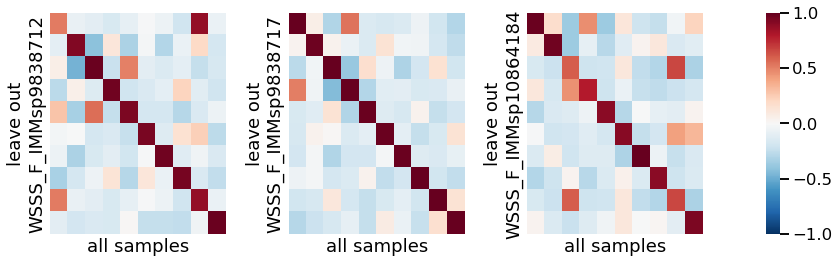

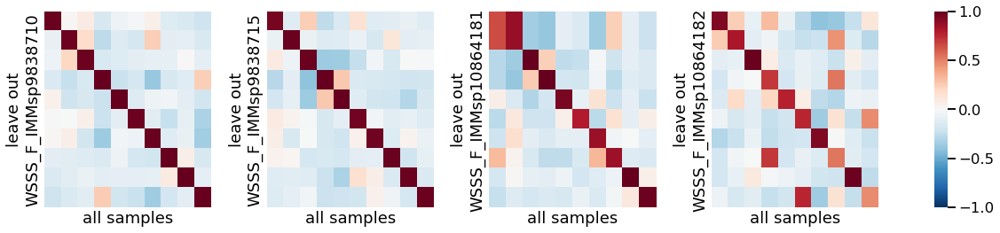

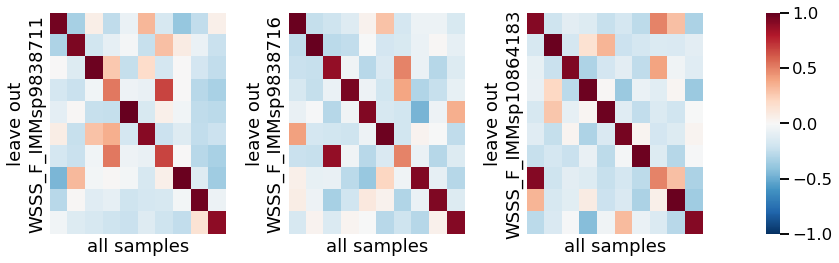

In [39]:
for i_org, org in enumerate(['LI','SP','TH']):
    adata = c2l_results[org]
    outdir = '/nfs/team205/ed6/data/Fetal_immune/spatial_analysis_outs/V2/'
    n_fact = 10
    sample_col = 'sample'

    ## Take out one sample
    outs = {}
    outs['cts'] = {}
    outs['locs'] = {}
    for s in adata.obs[sample_col].unique().tolist() + ['none']:
        X_cts = pd.read_csv(outdir + f"{org}_leaveout_{s}.celltype_fractions.csv", index_col=0)
        X_locations = pd.read_csv(outdir + f"{org}_leaveout_{s}.locations.csv", index_col=0)
        outs['cts'][s] = X_cts
        outs['locs'][s] = X_locations

    samples = adata.obs[sample_col].unique().tolist() 

    sns.set_context("talk");
    plt.rcParams['figure.figsize'] = (4*len(samples),4)
    f,axs = plt.subplots(1, len(samples)+1, gridspec_kw={'width_ratios':([1]*len(samples)) +[0.08]})
#     f,(ax1,ax2,ax3, axcb) = plt.subplots(1,4, 
#             gridspec_kw={'width_ratios':([1]*len(samples)) +[0.08]})
    for i,s in enumerate(samples):
        if i != len(samples) - 1:
            cbar = False
            cbar_ax = None
        else:
            cbar=True
            cbar_ax = axs[-1]
        cormat = np.corrcoef(outs['cts']['none'].T, outs['cts'][samples[i]].T)[:n_fact, n_fact:]
        max_cols = cormat.argmax(0)   
        sns.heatmap(cormat[max_cols,:], ax=axs[i], vmin=-1, vmax=1, cbar=cbar, cmap='RdBu_r', cbar_ax=cbar_ax);
        axs[i].set_xlabel('all samples'); axs[i].set_ylabel('leave out\n' + s );
        axs[i].set_xticks([]); axs[i].set_yticks([]);
    plt.tight_layout();
    plt.savefig(figdir + f"NMF_stability.{org}.pdf")

### Read NMF results

In [115]:
# def read_nmf(c2l_outdir, n_fact, out_type='ct_fractions', dirname=None):
#     nmf_outdir = c2l_outdir + 'CoLocatedComb/' + os.listdir(c2l_outdir + 'CoLocatedComb/')[0]
#     if dirname is not None:
#         nmf_outdir = c2l_outdir + 'CoLocatedComb/' + dirname
#     if out_type == 'ct_fractions':
#         ct_frac_outdir = nmf_outdir + "/cell_type_fractions_mean/"
#         fact_mat = [x for x in os.listdir(ct_frac_outdir) if "n_fact" + str(n_fact) in x][0]
#         out = pd.read_csv(ct_frac_outdir + fact_mat, index_col=0)
#     elif out_type == "location":
#         loc_outdir = nmf_outdir + "/location_factors_mean/"
#         fact_mat = [x for x in os.listdir(loc_outdir) if "n_fact" + str(n_fact) in x][0]
#         out = pd.read_csv(loc_outdir + fact_mat, index_col=0)
#     return(out)

def get_undetected_cts(adata_vis, vis_sample_metadata, detection_thresh = 0.15):
    max_val_sample = adata_vis.obs[adata_vis.uns['mod']['factor_names'].tolist() + ['sample']].groupby('sample').quantile(q=0.992).T
    return(max_val_sample.index[(max_val_sample < detection_thresh).sum(1) > 1])
    

# def get_colocation_from_nmf(adata_vis, vis_sample_metadata, c2l_outdir, n_factors, min_frac = 0.2, detection_thresh=0.15):
#     ## Read celltype fractions 
#     nmf_fractions = read_nmf(c2l_outdir, n_fact=n_factors)
#     ## Exclude undetected cts
#     exclude_cts = get_undetected_cts(adata_vis, vis_sample_metadata, detection_thresh=detection_thresh)
#     nmf_fractions = nmf_fractions[~nmf_fractions.index.isin(exclude_cts)]
#     ## Filter by minimum fraction associated to factor 
#     nmf_fractions = nmf_fractions.mask(nmf_fractions < min_frac, other=0)
#     coloc_df = nmf_fractions.mask(nmf_fractions > 0, other=1)
#     coloc_df.columns = ['fact_'+str(i) for i in range(n_factors)]
#     return(coloc_df)

# def pick_n_factors(c2l_outdir, n_fact_range=range(10,20)):
#     max_cors = []
#     for n in n_fact_range:
#         nmf_fractions = read_nmf(c2l_outdir, n_fact=n)
#         fact_cors = np.corrcoef(nmf_fractions.T)
#         np.fill_diagonal(fact_cors, 0)
#         max_cor = fact_cors.max()
#         max_cors.append(max_cor)
#     return(n_fact_range[np.argmin(max_cors)])

In [116]:
nmf_ct_fractions_files = {
    'SP':'/nfs/team205/ed6/data/Fetal_immune/spatial_analysis_outs/V2/SP_leaveout_none.celltype_fractions.csv',
    'LI':'/nfs/team205/ed6/data/Fetal_immune/spatial_analysis_outs/V2/LI_leaveout_none.celltype_fractions.csv',
    'TH':'/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/results/spatial_mapping_TH_fetal_TECs_revisedTissuefilter_v2annot_epochs50k_alphatest20/CoLocatedComb/CoLocatedGroupsSklearnNMF_4675locations_72factors/cell_type_fractions_mean/n_fact10.csv'
}

nmf_locations_files = {
    'SP':'/nfs/team205/ed6/data/Fetal_immune/spatial_analysis_outs/V2/SP_leaveout_none.locations.csv',
    'LI':'/nfs/team205/ed6/data/Fetal_immune/spatial_analysis_outs/V2/LI_leaveout_none.locations.csv',
    'TH':'/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/results/spatial_mapping_TH_fetal_TECs_revisedTissuefilter_v2annot_epochs50k_alphatest20/CoLocatedComb/CoLocatedGroupsSklearnNMF_4675locations_72factors/location_factors_mean/n_fact10.csv'
}

min_frac = 0.15
nmf_fractions_dict = {}
for o in organs:
    ct_fractions_df = pd.read_csv(nmf_ct_fractions_files[o], index_col=0)
    locations_df = pd.read_csv(nmf_locations_files[o], index_col=0)
    ## Read fraction values to locations
    c2l_results[o].obsm["NMF"] = locations_df.loc[c2l_results[o].obs_names]
    if 'mean_nUMI_factors' in c2l_results[o].obsm["NMF"].columns[0]:
        c2l_results[o].obsm["NMF"].columns = [x[1] for x in c2l_results[o].obsm["NMF"].columns.str.split("mean_nUMI_factors")]
    c2l_results[o].obsm["NMF"] = c2l_results[o].obsm["NMF"].mask(c2l_results[o].obsm["NMF"] < min_frac, 0)
    if any([x in c2l_results[o].obs.columns for x in c2l_results[o].obsm["NMF"].columns]):
        c2l_results[o].obs = c2l_results[o].obs.drop(c2l_results[o].obsm["NMF"].columns, 1)
    c2l_results[o].obs = pd.concat([c2l_results[o].obs, c2l_results[o].obsm["NMF"]], 1)

    nmf_fractions_dict[o] = ct_fractions_df.copy()
    if 'mean_cell_type_factors' in nmf_fractions_dict[o].columns[0]:
        nmf_fractions_dict[o].columns = [x[1] for x in nmf_fractions_dict[o].columns.str.split("mean_cell_type_factors")]
    ## Filter out celltypes not found across donors in sc data
    nmf_fractions_dict[o] = nmf_fractions_dict[o].loc[[x for x in nmf_fractions_dict[o].index if ct_donor_pass_filter(x, o) or  "TEC" in x]]

In [164]:
# dirnames = {
#     "SP":'CoLocatedGroupsSklearnNMF_11355locations_78factors',
#     "LI":'CoLocatedGroupsSklearnNMF_10351locations_81factors',
#     'TH':'CoLocatedGroupsSklearnNMF_4675locations_72factors'
# }

# min_frac = 0.15
# c2l_outdirs_dict = dict(zip(organs, c2l_outdirs))
# n_factors_dict = {k:10 for k in c2l_outdirs_dict.keys()}

# nmf_fractions_dict = {k:read_nmf(c2l_outdirs_dict[k], n_factors_dict[k]) for k in c2l_outdirs_dict.keys()}

# ## Read fraction values to locations
# for o in organs:
#     dirname = dirnames[o]
#     nmf_mat = read_nmf(c2l_outdirs_dict[o], n_fact=n_factors_dict[o], out_type='location', dirname=dirname)
#     c2l_results[o].obsm["NMF"] = nmf_mat.loc[c2l_results[o].obs_names]
#     c2l_results[o].obsm["NMF"].columns = [x[1] for x in c2l_results[o].obsm["NMF"].columns.str.split("mean_nUMI_factors")]
#     c2l_results[o].obsm["NMF"] = c2l_results[o].obsm["NMF"].mask(c2l_results[o].obsm["NMF"] < min_frac, 0)
#     ## Remove 0-based indexing
#     # c2l_results[o].obsm["NMF"].columns =  [x[0] + "_" + str(int(x[1]) + 1) for x in c2l_results[o].obsm["NMF"].columns.str.split("_")]
#     if any([x in c2l_results[o].obs.columns for x in c2l_results[o].obsm["NMF"].columns]):
#         c2l_results[o].obs = c2l_results[o].obs.drop(c2l_results[o].obsm["NMF"].columns, 1)
#     c2l_results[o].obs = pd.concat([c2l_results[o].obs, c2l_results[o].obsm["NMF"]], 1)

# ## Filter out celltypes not found across donors in sc data
# for o in organs:
#     nmf_fractions_dict[o] = nmf_fractions_dict[o].loc[[x for x in nmf_fractions_dict[o].index if ct_donor_pass_filter(x, o) or  "TEC" in x]]

### Plot factors and cell type fractions per organ

In [120]:
def plot_nmf_fractions_ct(pl_df, org_fs, outfile, hm_height=10, hm_width=12):
    r_fct_str = '''
    library(tidyverse)
    plot_nmf_fractions <- function(pl_df, org_fs, outfile, save=TRUE, pl_height=10, pl_width=12){
        p1 <- pl_df %>%
            rownames_to_column("cell_type") %>%
            pivot_longer(cols=- cell_type, names_to="factor", values_to="ct_fraction") %>%
            mutate(factor=str_remove(factor, "mean_cell_type_factors")) %>%
            group_by(cell_type) %>%
            mutate(top_fact = which.max(ct_fraction)) %>%
            ungroup() %>%
            arrange(top_fact) %>%
            mutate(cell_type=factor(cell_type, levels=unique(cell_type))) %>%
            filter(factor %in% org_fs) %>%
            mutate(factor = factor(str_replace(factor, "fact_", "Factor "), levels=str_replace(org_fs, "fact_", "Factor "))) %>%
            ggplot(aes(factor, cell_type, color=ct_fraction, size=ct_fraction)) +
            geom_point() +
            scale_color_viridis_c(option='magma', direction=-1, name="cell type\nfraction", guide = "legend") +
            scale_size(name="cell type\nfraction") +
            ylab("cell type") +
            theme_bw(base_size=14) +
            theme(axis.text.x=element_text(angle=45, hjust=1, vjust=1)
                 )
        if (isTRUE(save)){
            print(paste0('saving to ', outfile))
            ggsave(paste0(outfile, '.pdf'), p1, height=pl_height, width=pl_width)
            ggsave(paste0(outfile, '.png'), p1, height=pl_height, width=pl_width)
          } else {
           print("not saving")
          p1   
        }
    }
    '''

    import rpy2.robjects.pandas2ri
    import rpy2.robjects.numpy2ri
    from rpy2.robjects.packages import STAP

    r_pkg = STAP(r_fct_str, "r_pkg")
    # PASS OBJECTS INTO FUNCTION
    r_pkg.plot_nmf_fractions(pl_df, org_fs, outfile, pl_height = hm_height, pl_width = hm_width)

def plot_nmf_spatial(adata_vis, org_fs, lib, outfile, ncols=2):
    ## Save spatial plots 
    sns.set_context("talk")
    plt.rcParams["figure.figsize"] = [10,10]
    plt.rcParams['axes.titlesize'] = 32
    plt_titles = [None] + ["Factor " + x.split("_")[1] for x in org_fs.values]
    _spatial_plot_lib(adata_vis, color=[None] + list(org_fs.values), lib=lib, ncols=ncols, size=1.3, 
                      save=outfile, frameon=False,
                      title=plt_titles, show=False
                     )
    plt.rcParams['axes.titlesize'] = 20


def get_nmf_frac_4_plotting(nmf_fractions, org, org_fs, min_prop=0.25):
#     all_orgs = ["SP", "LI", "TH"]
    ## Filter cell types by minimum proportion assigned to fraction
    filt_nmf_fractions = nmf_fractions[nmf_fractions[org_fs].max(1) > min_prop]
    pl_df = filt_nmf_fractions[ org_fs ]

    ## Exclude low Q annotations
    pl_df = pl_df[~pl_df.index.isin(anno_groups_dict["OTHER"])]

    return(pl_df)

In [ ]:
for o in organs:
    for s in vis_sample_metadata[vis_sample_metadata.Organ==o].index:
        plot_nmf_spatial(c2l_results[o], c2l_results[o].obsm["NMF"].columns, 
                         lib=s, 
                         ncols=2,
                         outfile="{o}_{s}_factors_spatial.pdf".format(s=s, o=o)
                        )
# o = 'SP'
# for s in vis_sample_metadata[vis_sample_metadata.Organ==o].index:
#     plot_nmf_spatial(c2l_results[o], c2l_results[o].obsm["NMF"].columns, 
#                      lib=s, 
#                      ncols=2,
#                      outfile="{o}_{s}_factors_spatial.pdf".format(s=s, o=o)
#                     )

In [121]:
## Plotting params
pl_params = {
    "SP":{
        'lib':'WSSS_F_IMMsp9838715',
        'hm_height':12,
        'hm_width':8,
        'min_prop':0.2
      },
    "TH":{
        'lib':'WSSS_F_IMMsp9838716',
        'hm_height':12,
        'hm_width':8,
        'min_prop':0.2       
    },
    "LI":{
        'lib':'WSSS_F_IMMsp10864181',
        'hm_height':12,
        'hm_width':8,
        'min_prop':0.2         
    }
}

for org in ['TH', "LI", "SP"]:
    org_fs = c2l_results[org].obsm["NMF"].columns
#     plot_nmf_spatial(adata_vis, org_fs, pl_params[org]['lib'], outfile = 'top_factors_spatial_' + org + ".pdf")
    pl_df = get_nmf_frac_4_plotting(nmf_fractions_dict[org].loc[~nmf_fractions_dict[org].index.isin(get_undetected_cts(c2l_results[org], vis_sample_metadata))], 
                                    org, org_fs, min_prop=pl_params[org]['min_prop'])
    plot_nmf_fractions_ct(pl_df, org_fs, 
                          outfile=figdir + 'top_factors_' + org, 
                          hm_height=pl_params[org]['hm_height'],
                          hm_width=pl_params[org]['hm_width']
                         )

[1] "saving to /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/spatial_mapping_EDA/top_factors_TH"
[1] "saving to /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/spatial_mapping_EDA/top_factors_LI"
[1] "saving to /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/spatial_mapping_EDA/top_factors_SP"


#### Selected factors (Fig1)

In [126]:
broad_annotation_color = pd.read_csv('../../metadata/broad_annotation_colors.csv', index_col=0)

with open("../../metadata/broad_annotation_dict.json", 'rb') as f:
    anno_groups_lvl0 = json.load(f)
anno_groups_lvl0_rev = {x:g for g,a in anno_groups_lvl0.items() for x in a}

In [127]:
%%R -i broad_annotation_color
library(patchwork)

broad_anno_palette <- setNames(broad_annotation_color$color, rownames(broad_annotation_color))
plot_factor_id_colored <- function(nmf_fractions, f, min_frac= 0.1, n_top=NULL, basesize=16,
                           highlight_cts = NULL
                          ){
    highlight_color = 'red'
    nmf_frac_df <- nmf_fractions %>%
        rownames_to_column('celltype') %>%
         pivot_longer(cols=-c(celltype, broad_anno), names_to="factor") %>%
        mutate(factor=str_remove(factor, 'mean_cell_type_factors')) 
    nmf_frac_df <- nmf_frac_df %>%
     filter(factor==paste0('fact_',f)) %>%
        filter(value > min_frac) %>%
        arrange(value) %>%
        mutate(celltype=factor(celltype, levels=celltype)) 
#     %>%
#         filter(broad_anno != "OTHER")

    if (!is.null(n_top)){
        nmf_frac_df <- nmf_frac_df %>%
        top_n(n_top, value)
    }

    if (!is.null(highlight_cts)){
       nmf_frac_df <- nmf_frac_df %>%
        mutate(ct_highlight=celltype %in% highlight_cts)
        label_colors <- ifelse(nmf_frac_df$celltype %in% highlight_cts, highlight_color,'black')
        label_facefont <- ifelse(nmf_frac_df$celltype %in% highlight_cts, 'bold','plain')
    }


#     pl <- nmf_frac_df %>%
#         ggplot(aes(value, celltype, color=broad_anno, fill=broad_anno)) +
#         geom_point(size=5) +
#         geom_col(width=0.01) +
#         theme_bw(base_size=basesize) +
#         xlab("cell type fraction") +
#         coord_fixed(ratio=0.4) +
#         scale_x_continuous(breaks=c(0,0.5,1), expand=c(0,0.1)) +
#         scale_color_manual(values=broad_anno_palette, na.value="black", name="Cellular\ncompartment") +
#         scale_fill_manual(values=broad_anno_palette, na.value="black", name="Cellular\ncompartment") +
#         ggtitle(paste0("Factor", f)) +
#         theme(axis.text.y = element_text(colour = ifelse(!is.na(broad_anno_palette[nmf_frac_df$broad_anno]), broad_anno_palette[nmf_frac_df$broad_anno], 'black')),
#               axis.title.x=element_text(hjust=1)
#              )
    pl <- nmf_frac_df %>%
        ggplot(aes(0, celltype, color=broad_anno, fill=broad_anno)) +
        geom_point(aes(size=value)) +
        theme_bw(base_size=basesize) +
        xlab("") +
#         coord_fixed(ratio=1) +
        expand_limits(x=c(-0.25,0.25)) +
        scale_size(limits=c(0,1), range=c(0,8), name='cell type\nfraction') +
        scale_color_manual(values=broad_anno_palette, na.value="black", name="Cellular\ncompartment") +
        scale_fill_manual(values=broad_anno_palette, na.value="black", name="Cellular\ncompartment") +
        ggtitle(paste0("Factor", f)) +
        remove_x_axis() +
        theme(axis.text.y = element_text(colour = ifelse(!is.na(broad_anno_palette[nmf_frac_df$broad_anno]), broad_anno_palette[nmf_frac_df$broad_anno], 'black')),
              axis.title.x=element_text(hjust=1), panel.grid.major=element_blank(), panel.grid.minor=element_blank()
             ) 

    if (!is.null(highlight_cts)){
       pl <- pl +
        geom_point(data=. %>% filter(ct_highlight), size=6, color=highlight_color) +
        geom_col(data=. %>% filter(ct_highlight), color=highlight_color, width=0.02) +
        theme(axis.text.y = element_text(colour = label_colors, face=label_facefont))
    }
    return(pl)
    }

In [128]:
org='LI'
nmf_fracs = nmf_fractions_dict[org]
tot_abundance = c2l_results[org].obs[nmf_fracs.index].sum(0).values
# nmf_fracs = (nmf_fracs.T * tot_abundance).T
# nmf_fracs = (nmf_fracs/nmf_fracs.sum(0))

In [129]:
nmf_fracs = nmf_fracs.loc[~nmf_fracs.index.isin(get_undetected_cts(c2l_results[org], vis_sample_metadata))]
nmf_fracs['broad_anno'] = [anno_groups_lvl0_rev[x] if x in anno_groups_lvl0_rev.keys() else np.nan for x in nmf_fracs.index]

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


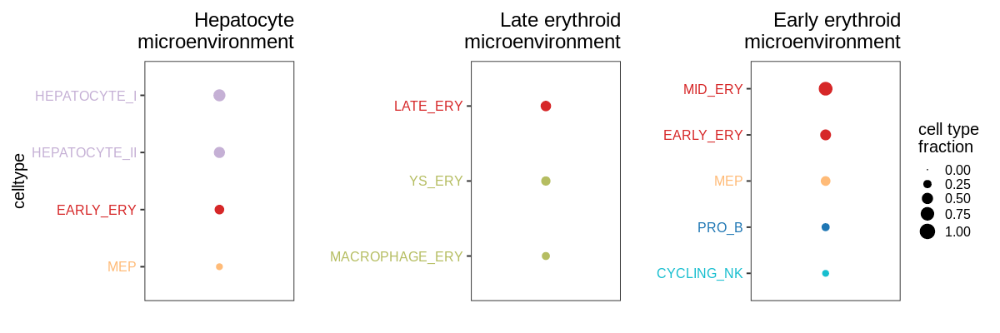

In [133]:
%%R -i nmf_fracs -i broad_annotation_color -w 1200 -h 400 -i figdir
library(patchwork)
n_top = 5
f_pl_1 <- plot_factor_id_colored(nmf_fracs, f=6, min_frac= 0.15, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Hepatocyte\nmicroenvironment") +
    theme(plot.title=element_text(hjust=1))

f_pl_2 <- plot_factor_id_colored(nmf_fracs, f=0, min_frac= 0.15, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Late erythroid\nmicroenvironment") +
    theme(plot.title=element_text(hjust=1))

f_pl_3 <- plot_factor_id_colored(nmf_fracs, f=9, min_frac= 0.15, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Early erythroid\nmicroenvironment") +
    theme(plot.title=element_text(hjust=1))
    
li_pl <- (f_pl_1 + 
(f_pl_2 + ylab('')) + 
(f_pl_3 + ylab(""))) + plot_layout(guides='collect')
li_pl +
ggsave(paste0(figdir, "LI_factor_ids.fig1D.pdf"), width=16, height=3)

In [138]:
org='TH'
nmf_fracs = nmf_fractions_dict[org]
# tot_abundance = c2l_results[org].obs[nmf_fracs.index].sum(0).values
# nmf_fracs = (nmf_fracs.T * tot_abundance).T
# nmf_fracs = (nmf_fracs/nmf_fracs.sum(0))

In [139]:
nmf_fracs = nmf_fracs.loc[~nmf_fracs.index.isin(get_undetected_cts(c2l_results[org], vis_sample_metadata))]
nmf_fracs['broad_anno'] = [anno_groups_lvl0_rev[x] if x in anno_groups_lvl0_rev.keys() else np.nan for x in nmf_fracs.index]

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


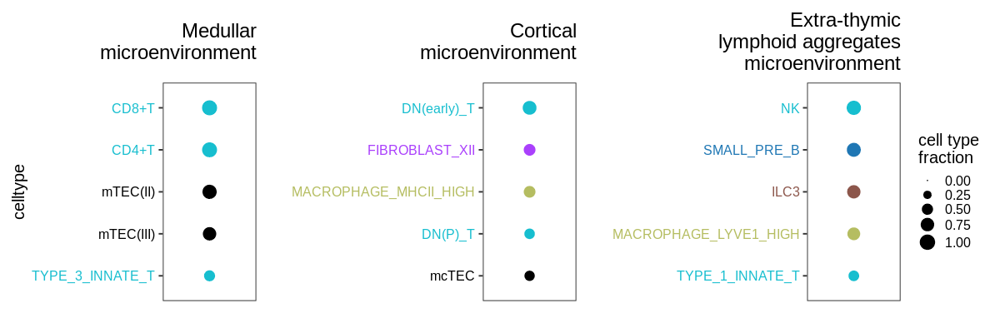

In [140]:
%%R -i nmf_fracs -i broad_annotation_color -w 1200 -h 400 -i figdir
library(patchwork)
n_top = 5
f_pl_1 <- plot_factor_id_colored(nmf_fracs, f=1, min_frac= 0.1, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Medullar\nmicroenvironment") +
    theme(plot.title=element_text(hjust=1))

f_pl_2 <- plot_factor_id_colored(nmf_fracs, f=5, min_frac= 0.05, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Cortical\nmicroenvironment") +
    theme(plot.title=element_text(hjust=1))

f_pl_3 <- plot_factor_id_colored(nmf_fracs, f=3, min_frac= 0.05, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Extra-thymic\nlymphoid aggregates\nmicroenvironment") +
    theme(plot.title=element_text(hjust=1))
    
th_pl <- (f_pl_1 + 
(f_pl_2 + ylab('')) + 
(f_pl_3 + ylab(""))) + plot_layout(guides='collect')
th_pl +
ggsave(paste0(figdir, "TH_factor_ids.fig1D.pdf"), width=16, height=3)

In [134]:
org='SP'
nmf_fracs = nmf_fractions_dict[org]
# tot_abundance = c2l_results[org].obs[nmf_fracs.index].sum(0).values
# nmf_fracs = (nmf_fracs.T * tot_abundance).T
# nmf_fracs = (nmf_fracs/nmf_fracs.sum(0))

In [135]:
nmf_fracs = nmf_fracs.loc[~nmf_fracs.index.isin(get_undetected_cts(c2l_results[org], vis_sample_metadata))]
nmf_fracs['broad_anno'] = [anno_groups_lvl0_rev[x] if x in anno_groups_lvl0_rev.keys() else np.nan for x in nmf_fracs.index]

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


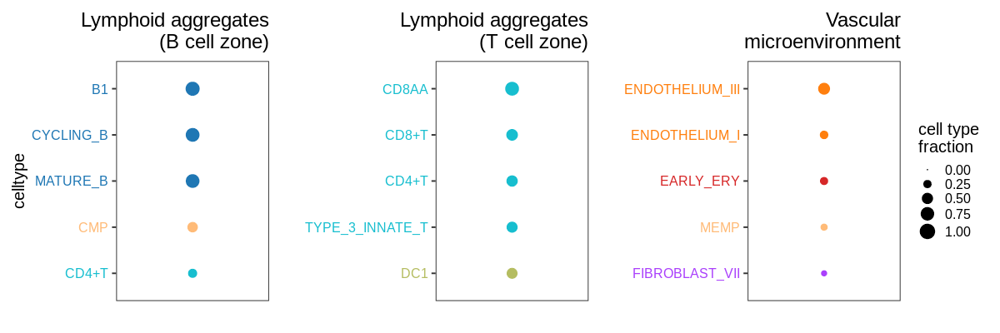

In [137]:
%%R -i nmf_fracs -i broad_annotation_color -w 1200 -h 400 -i figdir
library(patchwork)
n_top = 5
f_pl_1 <- plot_factor_id_colored(nmf_fracs, f=5, min_frac= 0, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Lymphoid aggregates\n(B cell zone)") +
    theme(plot.title=element_text(hjust=1))

f_pl_2 <- plot_factor_id_colored(nmf_fracs, f=3, min_frac= 0, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Lymphoid aggregates\n(T cell zone)") +
    theme(plot.title=element_text(hjust=1))

f_pl_3 <- plot_factor_id_colored(nmf_fracs, f=7, min_frac= 0, n_top=n_top, basesize=20) + 
    guides(fill='none', color='none') +
    ggtitle("Vascular\nmicroenvironment") +
    theme(plot.title=element_text(hjust=1))
    
sp_pl <- (f_pl_1 + 
(f_pl_2 + ylab('')) + 
(f_pl_3 + ylab(""))) + plot_layout(guides='collect')

sp_pl +
ggsave(paste0(figdir, "SP_factor_ids.fig1D.pdf"), width=12, height=3)

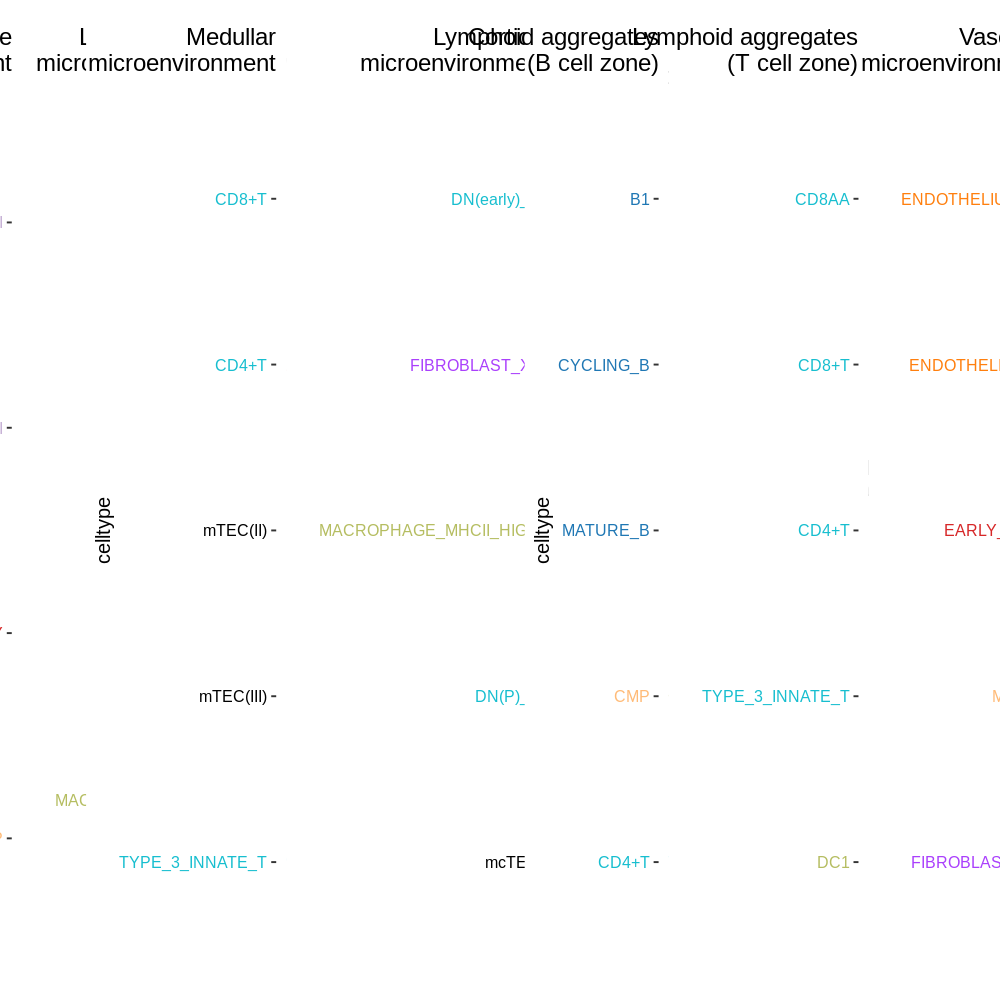

In [141]:
%%R -w 1000 -h 1000

(li_pl | th_pl | sp_pl) +
plot_layout(guides='collect', widths=c(1,1.3,1.2)) +
ggsave(paste0(figdir, "all_factor_ids.fig1D.pdf"), width=35, height=3.5)

... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical


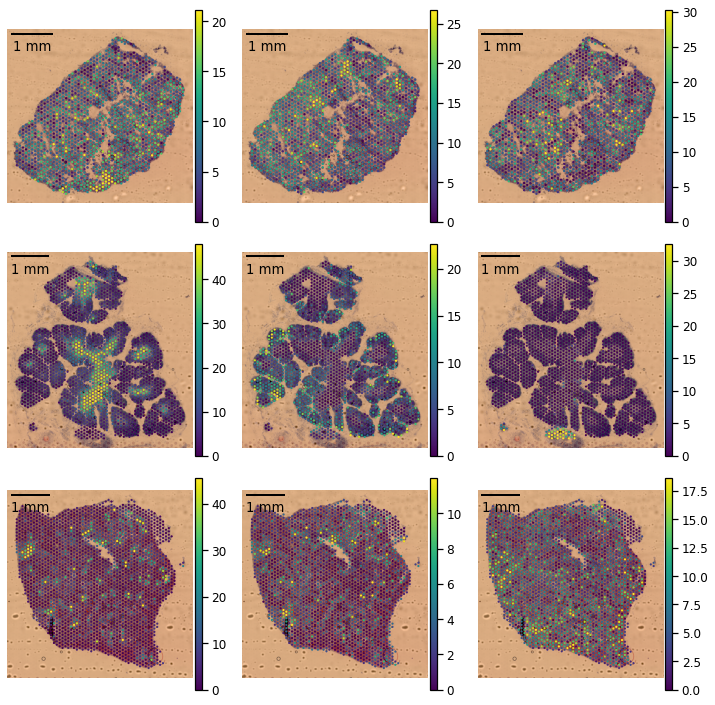

In [142]:
pl_params = {
    # liver
    'WSSS_F_IMMsp9838717':['fact_6', 'fact_0', 'fact_9'],
    # thymus
    'WSSS_F_IMMsp9838716':['fact_1', 'fact_5', 'fact_3'],
    # spleen
    'WSSS_F_IMMsp9838715':['fact_5', 'fact_3', 'fact_7'],
    }

all_organs = ['LI', "TH", "SP"]
samples = list(pl_params.keys())
# col_names = [x['org_fs'] for x in pl_params.values()]

n_samples = len(samples)
nrow = 3
ncol = 3
fig, axs = plt.subplots(nrow, ncol, figsize=(10,10))
if nrow == 1:
    axs = axs.reshape((1, ncol))

from itertools import chain
ind = list(chain(*[[(j, i) for i in range(nrow)] for j in range(ncol)]))

pos_ix = 0
for i, s in enumerate(samples):
    for j, c in enumerate(pl_params[s]):
        vmax = np.quantile(c2l_results[all_organs[i]][c2l_results[all_organs[i]].obs["sample"].isin([s])].obs[c].values, 0.992)
        sns.set_context("notebook", font_scale=1.1)
        plt.rcParams["figure.figsize"] = [10,10]
        plt.rcParams['axes.titlesize'] = 32
        _spatial_plot_lib(c2l_results[all_organs[i]], color=[c], lib=s, ncols=1, size=1, 
                          vmin=0, vmax=vmax,
                          cmap="viridis", frameon=False, title="",
                          ax=axs[ind[pos_ix][0],ind[pos_ix][1]], show=False,
                          img_key='hires'
                         )
        pix_size = get_pixel_size_visium(c2l_results[all_organs[i]], 
                                         [x for x in c2l_results[all_organs[i]].uns['spatial'].keys() if s in x][0], 
                                         img='hires')
        scalebar = ScaleBar(pix_size, "um", length_fraction=0.25, frameon=False, location='upper left')
        axs[ind[pos_ix][0],ind[pos_ix][1]].add_artist(scalebar)
        plt.locator_params(axis='y', nbins=3)
        plt.rcParams['axes.titlesize'] = 20
        pos_ix += 1

fig.tight_layout()
fig.savefig(figdir+"spatial.fig1D.pdf")

In [170]:
# sum_dict = {'LI': {'Hepatocytes': ['HEPATOCYTE_I', 'HEPATOCYTE_II'],
#   'Late erythroid': ['LATE_ERY'],
#   'Early/mid erythroid': ['EARLY_ERY', 'MID_ERY']},
#  'SP': {'NK/T CELLS': ['CYCLING_T',
#    'CD4+T',
#    'CD8+T',
#    'TREG',
#    'NK',
#    'CYCLING_NK',
#    'DP(P)_T',
#    'CD8AA',
#    'ABT(ENTRY)',
#    'DP(Q)_T',
#    'DN(P)_T',
#    'DN(early)_T',
#    'DN(Q)_T',
#    'TYPE_1_INNATE_T',
#    'TYPE_3_INNATE_T'],
#   'B CELLS': ['LARGE_PRE_B',
#    'PRE_PRO_B',
#    'PRO_B',
#    'CYCLING_B',
#    'SMALL_PRE_B',
#    'MATURE_B',
#    'B1',
#    'IMMATURE_B',
#    'LATE_PRO_B',
#    'PLASMA_B'],
#   'Macrophages': ['MACROPHAGE_PROLIFERATING',
#    'MACROPHAGE_MHCII_HIGH',
#    'MACROPHAGE_LYVE1_HIGH',
#    'MACROPHAGE_PERI',
#    'MACROPHAGE_ERY',
#    'MACROPHAGE_IRON_RECYCLING',
#    'MACROPHAGE_KUPFFER_LIKE',
#    'MACROPHAGE_TREM2']},
#  'TH': {'DP/DN T cells': ['DP(P)_T',
#    'DP(Q)_T',
#    'DN(P)_T',
#    'DN(early)_T',
#    'DN(Q)_T'],
#   'Mature T cells': ['CD4+T',
#    'CD8+T',
#    'TREG',
#    'CD8AA',
#    'TYPE_1_INNATE_T',
#    'TYPE_3_INNATE_T'],
#     'B cells':anno_groups_dict['B CELLS'],
#     'NK cells':['NK'],
#        }}

# o = 'SP'
# for k,v in sum_dict[o].items():
#     v_keep = [x for x in v if x in c2l_results[o].obs.columns]
#     c2l_results[o].obs[k] = c2l_results[o].obs[v_keep].sum(1)
#     samples=c2l_results[o].obs['sample'].unique()
#     plot_spatial_per_cell_type(c2l_results[o], cell_type=k, samples=samples, ncol=len(samples))

# o = 'TH'
# for k,v in sum_dict[o].items():
#     v_keep = [x for x in v if x in c2l_results[o].obs.columns]
#     c2l_results[o].obs[k] = c2l_results[o].obs[v_keep].sum(1)
#     samples=c2l_results[o].obs['sample'].unique()
#     plot_spatial_per_cell_type(c2l_results[o], cell_type=k, samples=samples, ncol=len(samples))

# o = 'LI'
# for k,v in sum_dict[o].items():
#     v_keep = [x for x in v if x in c2l_results[o].obs.columns]
#     c2l_results[o].obs[k] = c2l_results[o].obs[v_keep].sum(1)
#     samples=c2l_results[o].obs['sample'].unique()
#     plot_spatial_per_cell_type(c2l_results[o], cell_type=k, samples=samples, ncol=len(samples))

### Thymus SP T cells factors

In [400]:
factor_id_pl_str = '''plot_func <- function(params){
    nmf_fractions <- params[[1]]
    f <- params[[2]]
    min_frac <- params[[3]]
    nmf_frac_df <- nmf_fractions %>%
        rownames_to_column('celltype') %>%
         pivot_longer(cols=-celltype, names_to="factor") %>%
        mutate(factor=str_remove(factor, 'mean_cell_type_factors')) 
    pl <- nmf_frac_df %>%
     filter(factor==paste0('fact_',f)) %>%
        filter(value > min_frac) %>%
        arrange(value) %>%
        mutate(celltype=factor(celltype, levels=celltype)) %>%
        ggplot(aes(value, celltype)) +
        geom_point(size=5) +
        geom_col(color='black', width=0.01) +
        theme_bw(base_size=18) +
        xlab("celltype fraction") +
        ggtitle(paste0("Factor", f))
    return(pl)
    }'''

In [401]:
nmf_fractions_dict["TH"].to_csv('/home/jovyan/data/Fetal_immune/spatial_analysis_outs/TH_NMF_celltype_fractions.csv')
# nmf_fractions_dict["TH"].to_csv('/home/jovyan/data/Fetal_immune/spatial_analysis_outs/TH_NMF_celltype_fractions.medullar_SPT_factors.csv')

In [423]:
spt_cells = ['CYCLING_T',
 'CD4+T',
 'CD8+T',
 'TREG','CD8AA','TYPE_1_INNATE_T',
 'TYPE_3_INNATE_T']

org = 'TH'
nmf_frac = nmf_fractions_dict[org].loc[~nmf_fractions_dict[org].index.isin(get_undetected_cts(c2l_results[org], vis_sample_metadata))]
# nmf_frac = nmf_frac.drop('broad_anno', 1)

min_frac_total = 0.8
min_frac = 0.25
org = "TH"
spt_factors = ['fact_' + str(x) for x in np.where(nmf_frac.loc[spt_cells].max(0)[0:10] > min_frac_total)[0]]
spt_factors

['fact_1', 'fact_6']

In [424]:
pl_df = get_nmf_frac_4_plotting(nmf_frac, org, spt_factors, min_prop=min_frac)
plot_nmf_fractions_ct(pl_df, spt_factors, 
                      outfile=figdir + 'top_factors_SPTcells_' + org, 
                      hm_height=7,
                      hm_width=4
                     )

[1] "saving to /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/spatial_mapping_EDA/top_factors_SPTcells_TH"


In [425]:
pl_df

,mean_cell_type_factorsfact_1,mean_cell_type_factorsfact_6
ABT(ENTRY),0.000000,0.525168
CD4+T,0.940543,0.009144
CD8+T,0.943536,0.000000
CD8AA,0.082350,0.857302
CYCLING_NK,0.000000,0.529285
CYCLING_T,0.154988,0.780617
DC1,0.111182,0.741569
DC2,0.273841,0.000000
DN(Q)_T,0.000000,0.335203
MIGRATORY_DC,0.424185,0.341992


In [422]:
pl_df.to_csv('/home/jovyan/data/Fetal_immune/spatial_analysis_outs/TH_NMF_celltype_fractions.medullar_SPT_factors.csv')

... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical


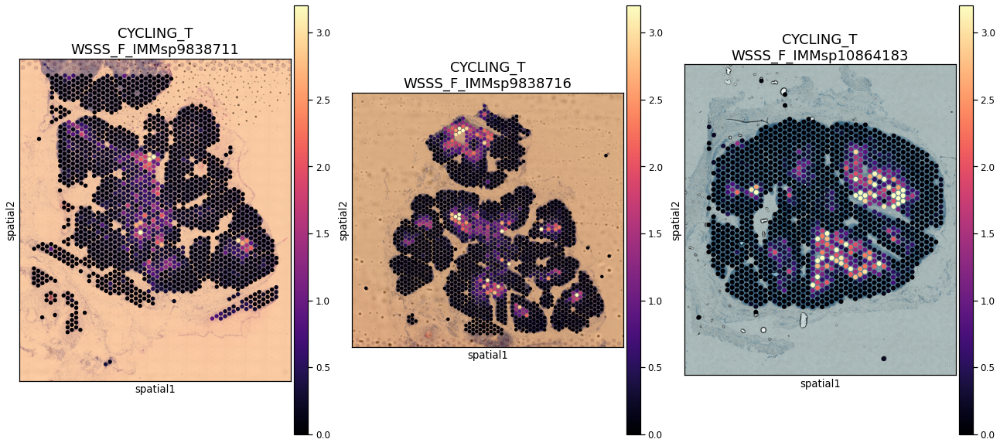

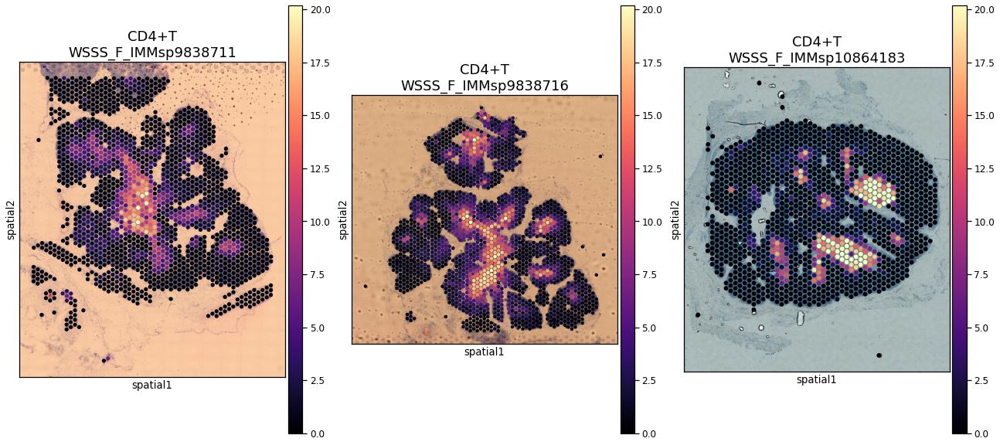

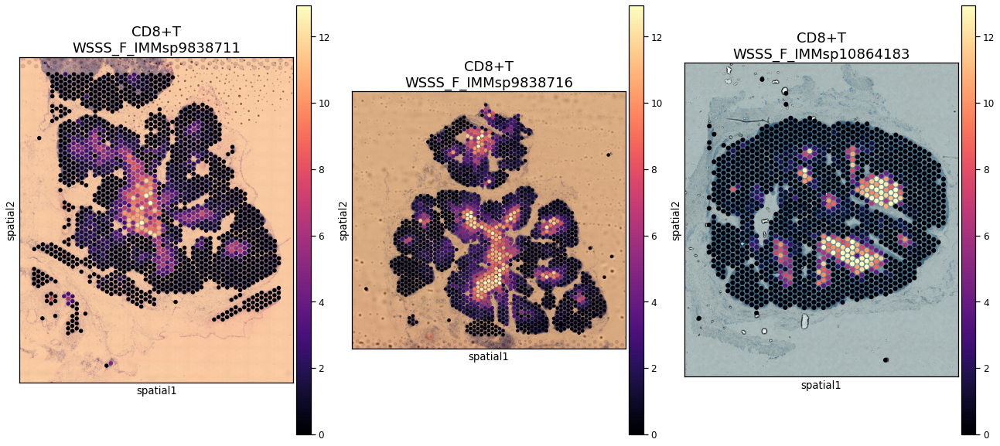

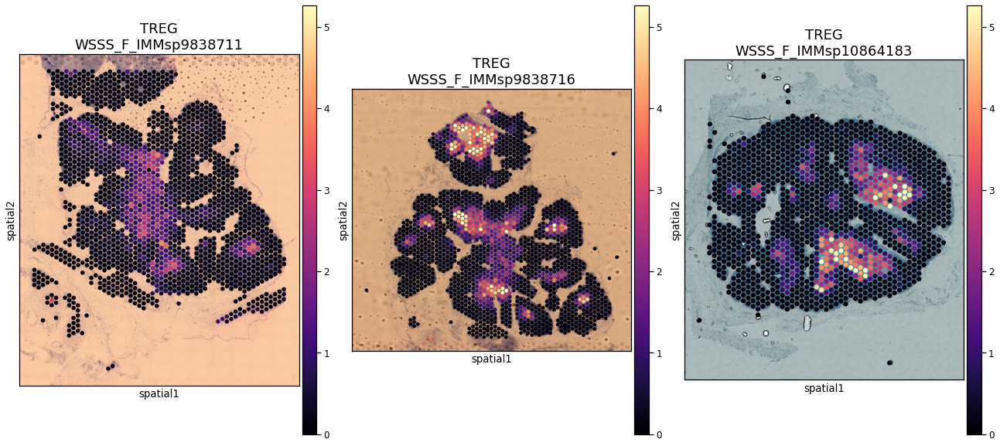

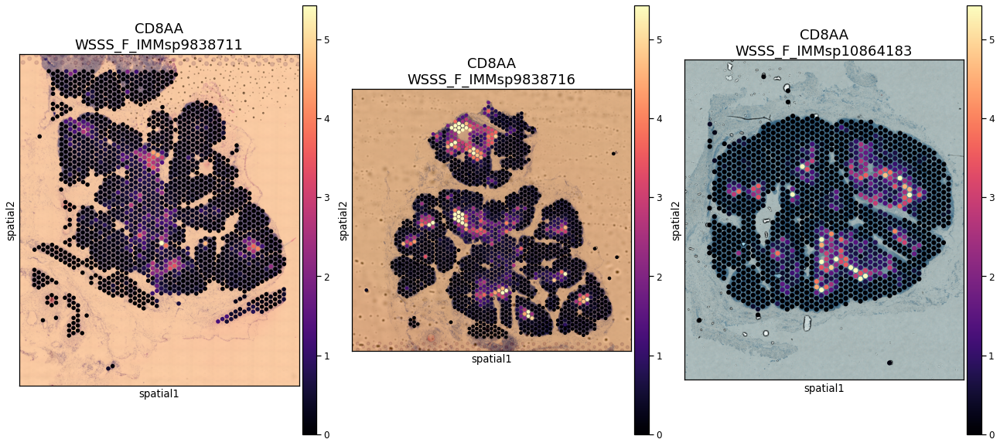

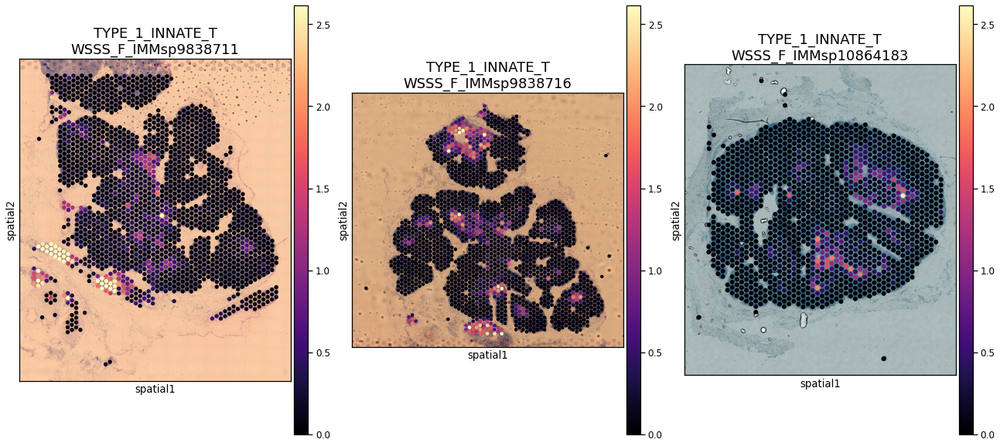

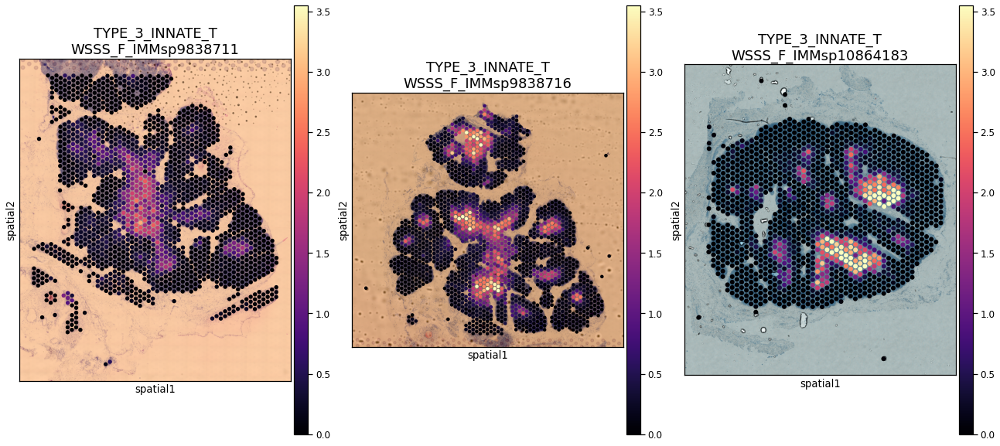

In [418]:
for ct in spt_cells:
    fig = plot_spatial_per_cell_type(c2l_results['TH'], cell_type=ct, samples=c2l_results['TH'].obs["sample"].unique(), ncol=3)
    fig.savefig(figdir + '{ct}_location_thymus.pdf'.format(ct=ct))

### B progenitor factors

In [144]:
## Add gut
outdir = '/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/results/spatial_mapping_multiorgan_GU_tissueQCfilter_epochs50k_alphatest20/'
gu_results = read_c2l(outdir, skip_organ=True)

In [145]:
c2l_results['GU'] = gu_results[0]

In [146]:
nmf_ct_fractions_files['GU'] = '/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/results/spatial_mapping_multiorgan_GU_tissueQCfilter_epochs50k_alphatest20/CoLocatedComb/CoLocatedGroupsSklearnNMF_1952locations_69factors/cell_type_fractions_mean/n_fact10.csv'
nmf_locations_files['GU'] = '/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/results/spatial_mapping_multiorgan_GU_tissueQCfilter_epochs50k_alphatest20/CoLocatedComb/CoLocatedGroupsSklearnNMF_1952locations_69factors/location_factors_mean/n_fact10.csv'

min_frac = 0.15

o = 'GU'
ct_fractions_df = pd.read_csv(nmf_ct_fractions_files[o], index_col=0)
locations_df = pd.read_csv(nmf_locations_files[o], index_col=0)
## Read fraction values to locations
c2l_results[o].obsm["NMF"] = locations_df.loc[c2l_results[o].obs_names]
if 'mean_nUMI_factors' in c2l_results[o].obsm["NMF"].columns[0]:
    c2l_results[o].obsm["NMF"].columns = [x[1] for x in c2l_results[o].obsm["NMF"].columns.str.split("mean_nUMI_factors")]
c2l_results[o].obsm["NMF"] = c2l_results[o].obsm["NMF"].mask(c2l_results[o].obsm["NMF"] < min_frac, 0)
if any([x in c2l_results[o].obs.columns for x in c2l_results[o].obsm["NMF"].columns]):
    c2l_results[o].obs = c2l_results[o].obs.drop(c2l_results[o].obsm["NMF"].columns, 1)
c2l_results[o].obs = pd.concat([c2l_results[o].obs, c2l_results[o].obsm["NMF"]], 1)

nmf_fractions_dict[o] = ct_fractions_df.copy()
if 'mean_cell_type_factors' in nmf_fractions_dict[o].columns[0]:
    nmf_fractions_dict[o].columns = [x[1] for x in nmf_fractions_dict[o].columns.str.split("mean_cell_type_factors")]
## Filter out celltypes not found across donors in sc data
nmf_fractions_dict[o] = nmf_fractions_dict[o].loc[[x for x in nmf_fractions_dict[o].index if ct_donor_pass_filter(x, o) or  "TEC" in x]]

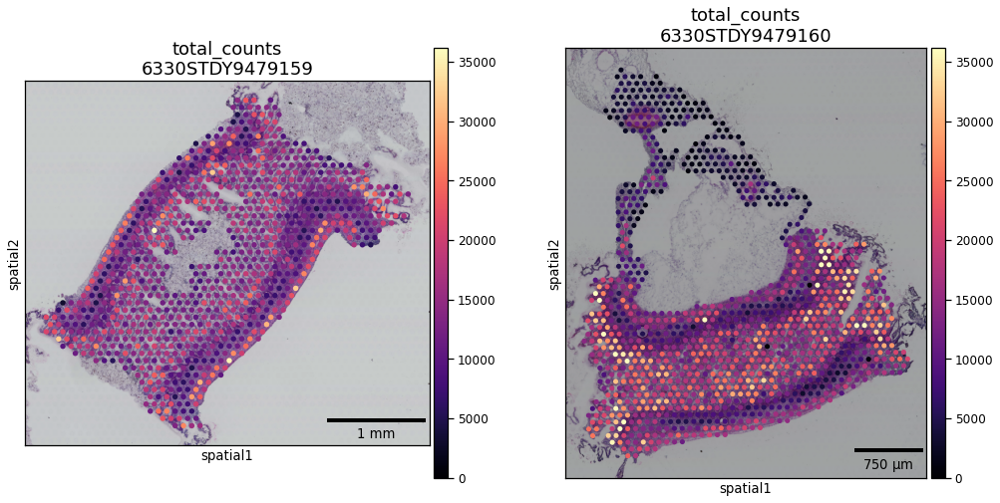

In [147]:
plt.rcParams['axes.titlesize'] = 18
org="GU"
n_samples = c2l_results[org].obs["sample"].unique().shape[0]
fig = plot_spatial_per_cell_type(c2l_results[org], cell_type='total_counts', 
                        samples=c2l_results[org].obs["sample"].unique(), 
                        ncol=n_samples, figsize=[7*n_samples, 7])
fig.savefig(figdir + '_total_counts_{o}.pdf'.format(o=org))

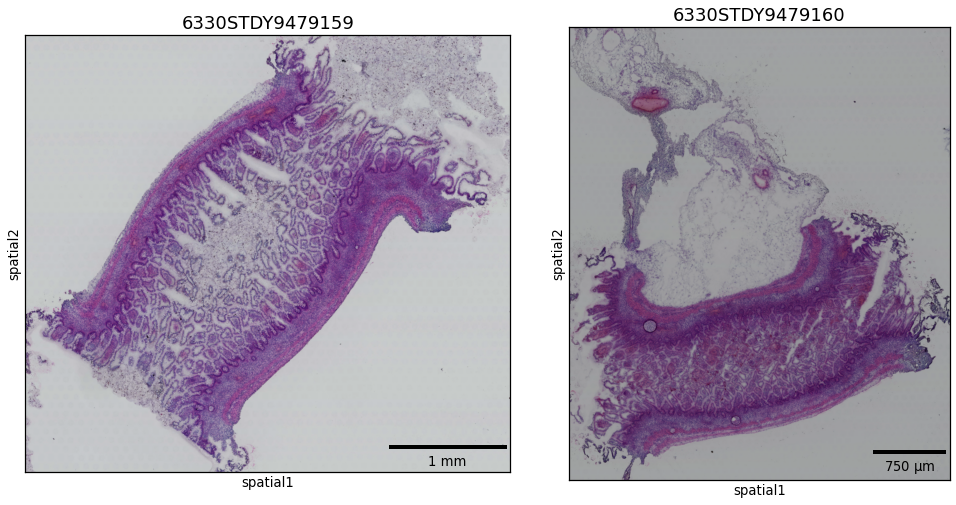

In [148]:
plt.rcParams['axes.titlesize'] = 18
org="GU"
n_samples = c2l_results[org].obs["sample"].unique().shape[0]
fig = plot_spatial_per_cell_type(c2l_results[org], cell_type=None, 
                        samples=c2l_results[org].obs["sample"].unique(), 
                        ncol=n_samples, figsize=[7*n_samples, 7])
fig.savefig(figdir + '_hne_{o}.pdf'.format(o=org))

In [149]:
org = 'GU'
org_fs = c2l_results[org].obsm["NMF"].columns
pl_df = get_nmf_frac_4_plotting(nmf_fractions_dict[org].loc[~nmf_fractions_dict[org].index.isin(get_undetected_cts(c2l_results[org], vis_sample_metadata))], 
                                org, org_fs, min_prop=0.2)
plot_nmf_fractions_ct(pl_df, org_fs, 
                          outfile=figdir + 'top_factors_' + org, 
                          hm_height=15,
                          hm_width=8
                         )

[1] "saving to /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/spatial_mapping_EDA/top_factors_GU"


In [150]:
progenitor_groups = {
    'T_prog':["DN(early)_T","DN(Q)_T", "DN(P)_T"],
    'B_prog' :['PRE_PRO_B','PRO_B','LATE_PRO_B','LARGE_PRE_B','SMALL_PRE_B'],
    'MEM_prog' : ['MEMP', 'CYCLING_MEMP', 'MEP'],
    'MYE_prog' : ['CMP','DC_PROGENITOR','GMP','MOP','MYELOCYTE','PROMONOCYTE','PROMYELOCYTE']
    }

progenitor_groups_rev = {x:k for k,v in progenitor_groups.items() for x in v }

In [151]:
all_organs = ['LI', "TH", "SP", "GU"]

In [171]:
min_frac = 0.5
bprog_factors = {}
for org in all_organs:
    keep_b_prog = [x for x in progenitor_groups['B_prog'] if x in nmf_fractions_dict[org].index]
    bprog_factors[org] = ['fact_' + str(x) for x in np.where(nmf_fractions_dict[org].loc[keep_b_prog].sum(0)[0:10] > min_frac)[0]]

bprog_factors

{'LI': ['fact_2', 'fact_5', 'fact_6', 'fact_7', 'fact_9'],
 'TH': ['fact_3', 'fact_9'],
 'SP': ['fact_1', 'fact_2', 'fact_8'],
 'GU': ['fact_4']}

In [172]:
orgs_pl_df = {}
for org in all_organs:
    org_fs = bprog_factors[org]
    pl_df = get_nmf_frac_4_plotting(nmf_fractions_dict[org], 
                                    org, org_fs, min_prop=0.15)
    pl_df['organ'] = org
    pl_df['celltype'] = pl_df.index
    pl_df = pl_df.melt(id_vars=['organ', 'celltype'])
    orgs_pl_df[org] = pl_df

orgs_pl_df = pd.concat([x for x in orgs_pl_df.values()], 0)

In [173]:
## Order celltypes by no. of organs in which they interact w B progenitors
shared_ct_rank = orgs_pl_df[['organ', 'celltype']].drop_duplicates().\
    groupby('celltype').size().\
    sort_values().\
    reset_index()
shared_ct_rank.columns = ['celltype', 'n_organs']

In [174]:
orgs_pl_df = pd.merge(orgs_pl_df, shared_ct_rank, how='left')

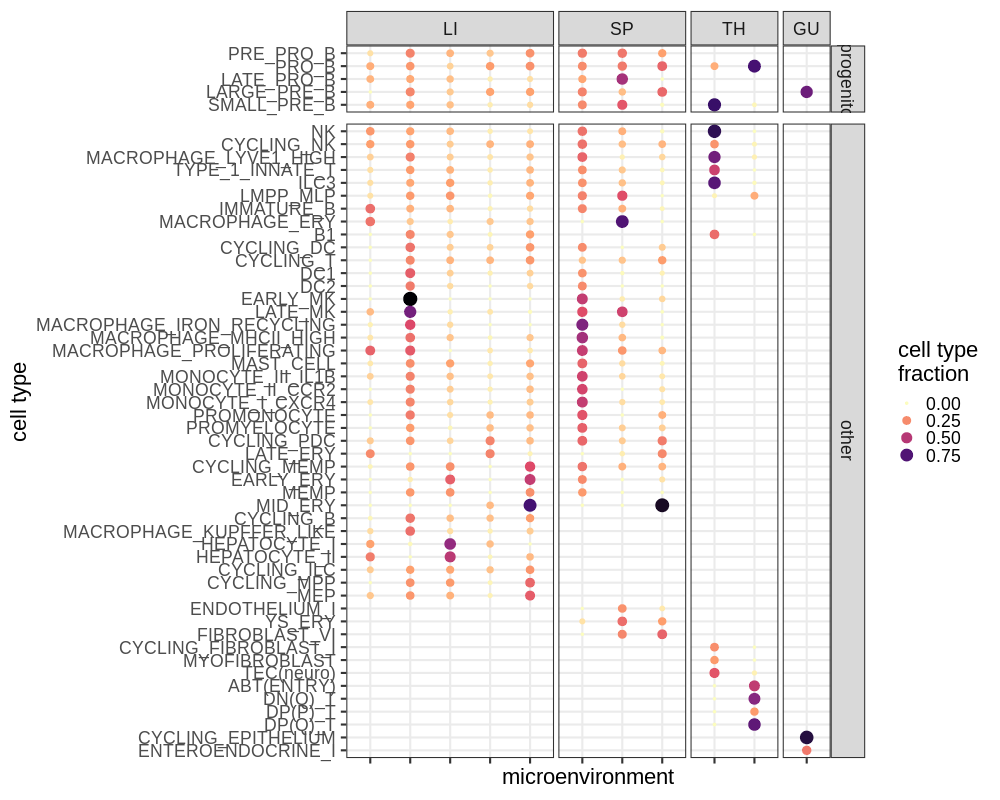

In [187]:
%%R -i orgs_pl_df -w 1000 -h 800 -o orgs_pl_df -i figdir
b_prog <- c('PRE_PRO_B','PRO_B','LATE_PRO_B','LARGE_PRE_B','SMALL_PRE_B')

keep_cts <- orgs_pl_df %>%
        mutate(factor=str_remove(variable, "mean_cell_type_factors")) %>%
        group_by(organ, factor) %>%    
        slice_max(order_by = value, n = 10) %>%
        pull(celltype) %>% unique()
        
orgs_pl_df %>%
    filter(celltype %in% keep_cts) %>%
    mutate(B_prog = ifelse(celltype %in% b_prog, 'B progenitors', 'other')) %>%
    mutate(factor=str_remove(variable, "mean_cell_type_factors")) %>%
    mutate(factor=paste0(factor,organ)) %>%
            group_by(celltype, organ, B_prog) %>%
            mutate(top_fact = which.max(value)) %>%
            ungroup() %>%
            mutate(organ=factor(organ, levels=c("LI", "SP", "TH", "GU"))) %>%
            arrange(desc(n_organs),organ, top_fact) %>%
            mutate(celltype=factor(celltype, levels=c(rev(c("PRE_PRO_B", "PRO_B", "LATE_PRO_B", "LARGE_PRE_B", "SMALL_PRE_B")),
                                                      rev(unique(celltype)[!unique(celltype) %in% c("PRE_PRO_B", "PRO_B", "LATE_PRO_B", "LARGE_PRE_B", "SMALL_PRE_B")])))) %>%
            ggplot(aes(factor, celltype, color=value, size=value)) +
            geom_point() +
            scale_color_viridis_c(option='magma', direction=-1, name="cell type\nfraction", guide = "legend") +
            scale_size(name="cell type\nfraction") +
            ylab("cell type") + xlab("microenvironment") +
            facet_grid(B_prog~organ, scales='free', space="free") +
            theme_bw(base_size=22) +
#             expand_limits(x = 0) +
            theme(axis.text.x=element_blank(),panel.spacing.x = unit(0.3, "lines")
#                   strip.text.y=element_text(angle=0)
                 ) +
            ggsave(paste0(figdir, 'Bprog_factors_heatmap_v1.pdf'), width=14, height=13)

In [305]:
orgs_pl_df.to_csv('/nfs/team205/ed6/data/Fetal_immune/spatial_analysis_outs/NMF_celltype_fractions.Bprogenitors.csv')

In [308]:
orgs_pl_df = {}
for org in all_organs:
    pl_df = get_nmf_frac_4_plotting(nmf_fractions_dict[org], 
                                    org, ['fact_' + str(x) for x in range(10)], min_prop=0.25)
    pl_df['organ'] = org
    pl_df['celltype'] = pl_df.index
    pl_df = pl_df.melt(id_vars=['organ', 'celltype'])
    orgs_pl_df[org] = pl_df

orgs_pl_df = pd.concat([x for x in orgs_pl_df.values()], 0)

In [309]:
orgs_pl_df.to_csv('/nfs/team205/ed6/data/Fetal_immune/spatial_analysis_outs/NMF_celltype_fractions.all_organs.csv')

Read output from cpdb analysis

In [1309]:
cpdb_df = pd.read_csv('/lustre/scratch117/cellgen/team205/cs42/panfetal/B_prog_cpdb/B_prog_cpdb.csv')


cpdb_df.index = cpdb_df['ligand_pair']
cpdb_df = cpdb_df.drop(['ligand_pair'], 1)

## Cluster genes
from scipy.cluster.hierarchy import ward, dendrogram, leaves_list
clustering = ward(cpdb_df.values)
ordered_genes = cpdb_df.index[leaves_list(clustering)].tolist()
# X_pl_df = X_pl_df[ordered_genes + ['n_cells', 'organ', 'age_bins'] ]
ordered_genes = np.array(ordered_genes)

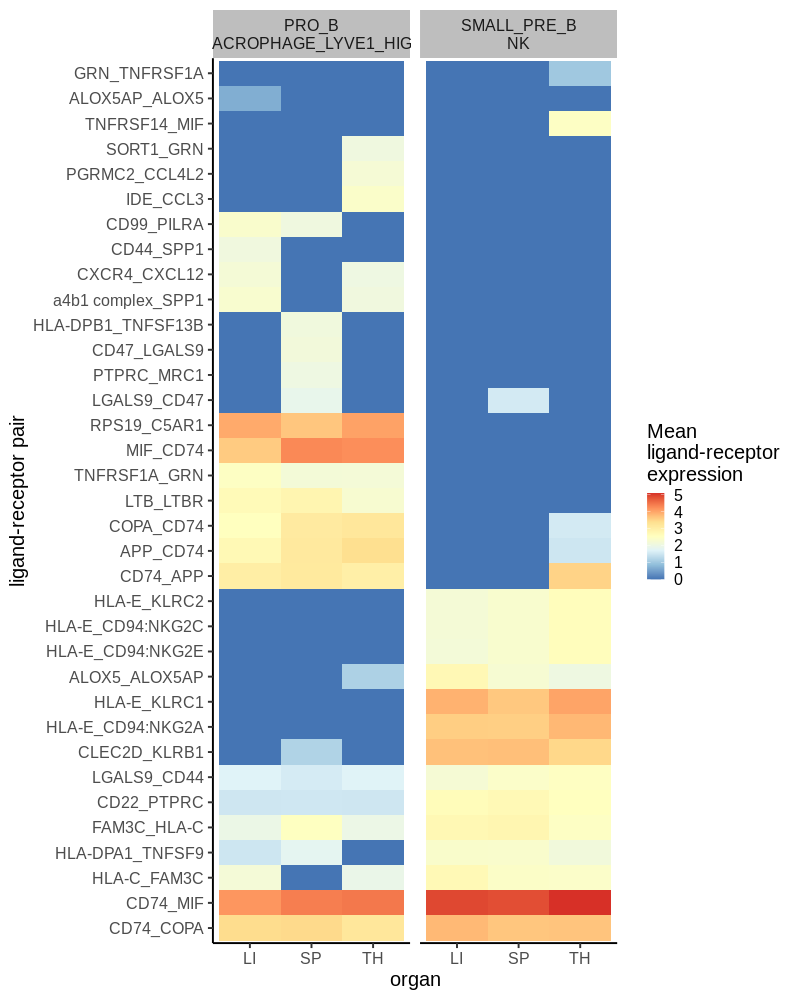

In [1336]:
%%R -i cpdb_df -i ordered_genes -w 800 -h 1000
cpdb_df %>%
    rownames_to_column('ligand_pair') %>%
    pivot_longer(cols=-c('ligand_pair'), names_to='celltype', values_to='mean_of_means') %>%
    separate('celltype', into=c("organ", 'celltype_pair'), sep='-') %>%
    mutate(ligand_pair=factor(ligand_pair, levels=ordered_genes)) %>%
    mutate(celltype_pair = str_replace(celltype_pair, '\\.', '\n')) %>%
    ggplot(aes(organ, ligand_pair, fill=mean_of_means)) +
    geom_tile() +
    facet_grid(.~celltype_pair) +
    scale_fill_distiller(palette="RdYlBu", name='Mean\nligand-receptor\nexpression') +
    ylab("ligand-receptor pair") +
    theme_classic(base_size=20) +
    theme(strip.background=element_rect(fill='grey', color=NA)) +
    ggsave(paste0(figdir, 'B_prog_cpdb_plot.pdf'), width=11, height=10)

#### plot B progenitor locations

... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical


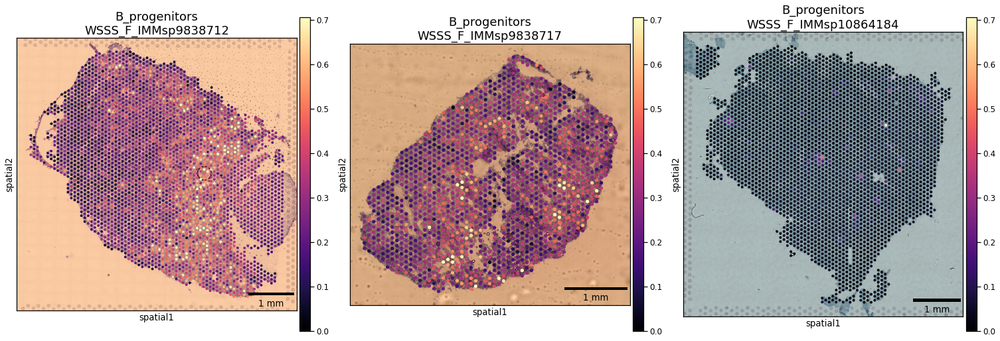

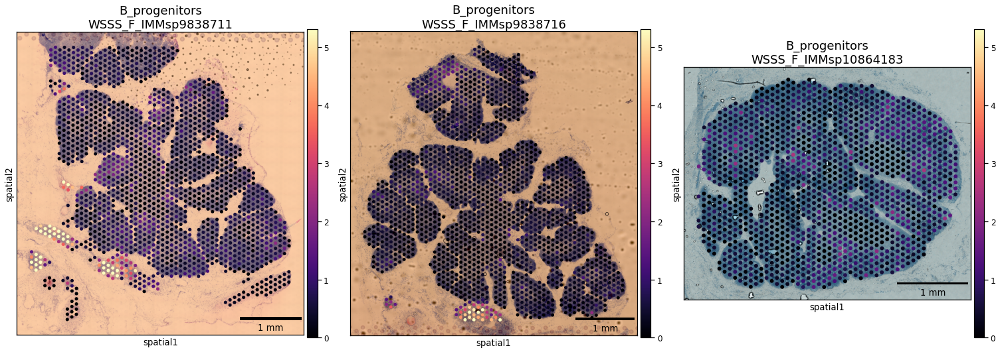

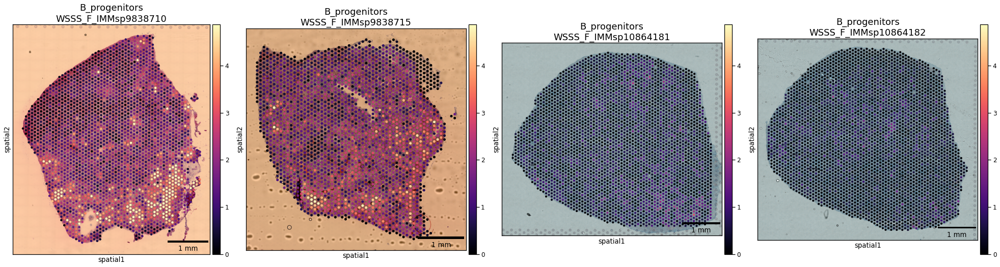

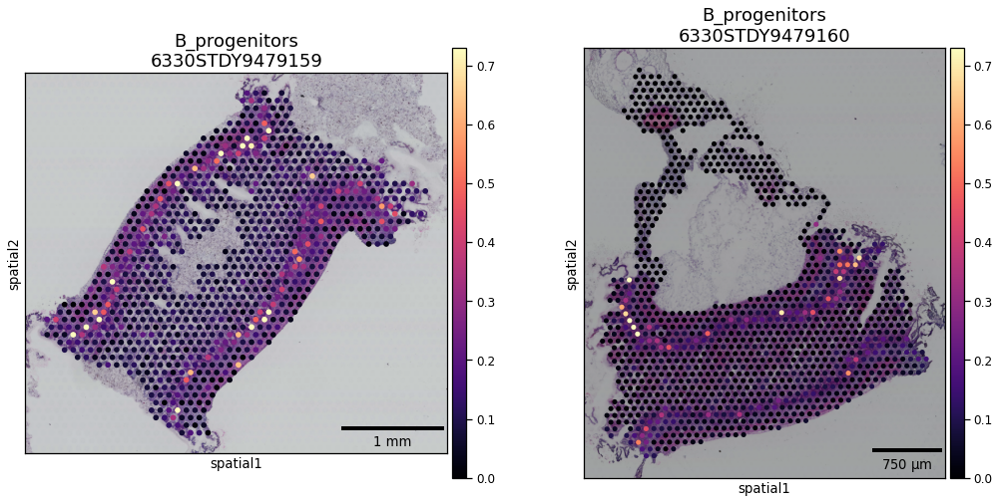

In [157]:
plt.rcParams['axes.titlesize'] = 18
for org in all_organs:
    keep_prog = [x for x in progenitor_groups['B_prog'] \
                 if x not in get_undetected_cts(c2l_results[org], vis_sample_metadata) and \
                 x in c2l_results[org].obs.columns
                ]
    c2l_results[org].obs['B_progenitors'] = c2l_results[org].obs[keep_prog].sum(1)
    n_samples = c2l_results[org].obs["sample"].unique().shape[0]
    fig = plot_spatial_per_cell_type(c2l_results[org], cell_type='B_progenitors', 
                            samples=c2l_results[org].obs["sample"].unique(), 
                            ncol=n_samples, figsize=[7*n_samples, 7])
    fig.savefig(figdir + 'B_progenitors_location_{o}.pdf'.format(o=org))

### Plot zoom ins

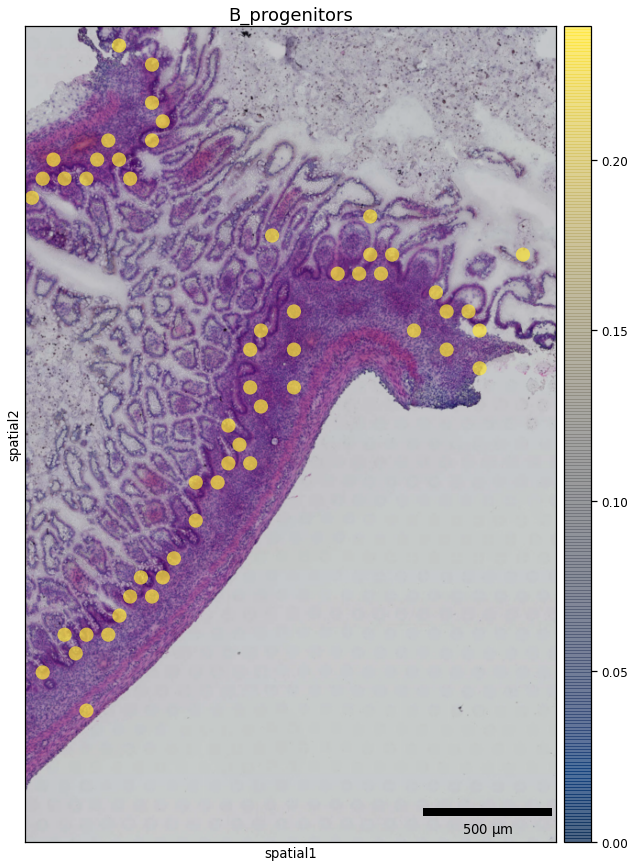

In [223]:
plt.rcParams['figure.figsize'] = [15,15]
lib_id = 'spaceranger121_count_35963_6330STDY9479159_GRCh38-3_0_0'
org='GU'
fig, ax = plt.subplots()
quant = np.quantile(c2l_results[org][c2l_results[org].obs['sample'] == '6330STDY9479159'].obs["B_progenitors"], 0.9)
pix_size = get_pixel_size_visium(c2l_results[org], lib_id, img='hires')
keep_obs = c2l_results[org][c2l_results[org].obs['sample'] == '6330STDY9479159'].obs["B_progenitors"] > quant
sc.pl.spatial(c2l_results[org][c2l_results[org].obs['sample'] == '6330STDY9479159'][keep_obs], 
              color='B_progenitors', img_key='hires', cmap='cividis',
             library_id=lib_id, size=1, vmax=quant, vmin=0,alpha=0.7,
             crop_coord=[2000,3335,1194,3245], show=False, ax=ax)
scalebar = ScaleBar(pix_size, "um", length_fraction=0.25, frameon=False, location='lower right')
ax.add_artist(scalebar)

In [ ]:
## Define factors for lymphoid aggregates
lym_aggregates_factor = 'fact_8'

samples = vis_sample_metadata.index[vis_sample_metadata.Organ=="SP"]
c2l_results["SP"].obs['lym_aggregate_region'] = 0
for s in samples:
    keep_obs = c2l_results["SP"].obs['sample'] == s
    quant = np.quantile(c2l_results["SP"].obs.loc[keep_obs, lym_aggregates_factor], 0.9)
    c2l_results["SP"].obs.loc[keep_obs, 'lym_aggregate_region'] = (c2l_results["SP"].obs.loc[keep_obs, lym_aggregates_factor] > quant).astype('int')

Trying to set attribute `.obs` of view, copying.
... storing 'Organ' as categorical


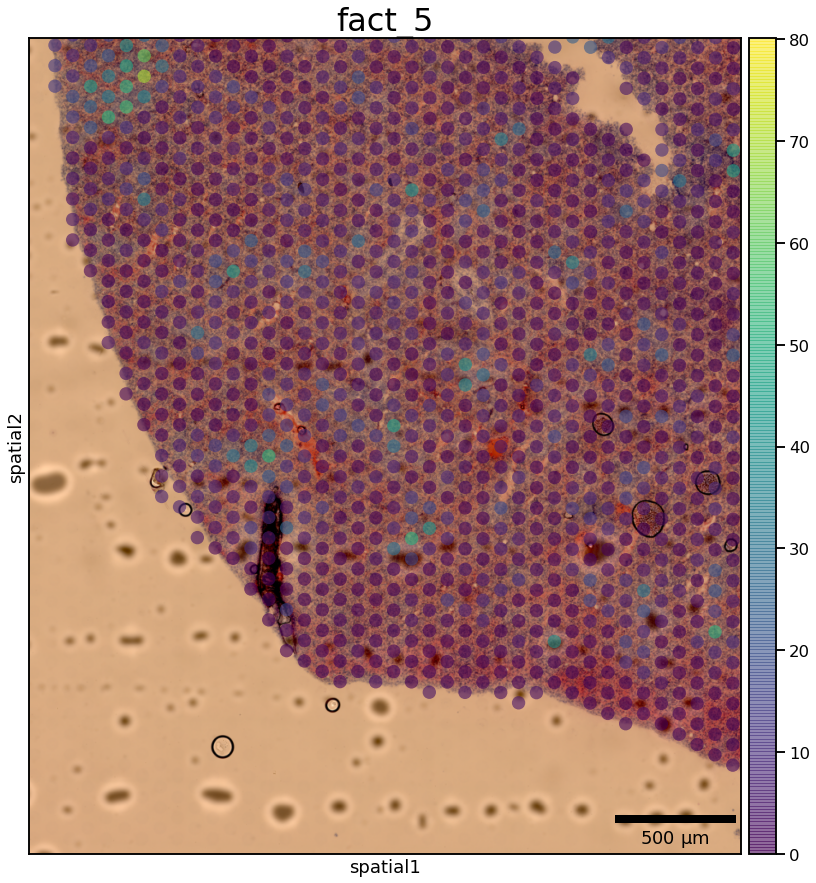

In [125]:
plt.rcParams['figure.figsize'] = [15,15]
org = 'SP'
s = 'WSSS_F_IMMsp9838715'
pl_obs= 'fact_5'

lib_id = [x for x in c2l_results[org].uns['spatial'].keys() if s in x][0]
fig, ax = plt.subplots()
quant = np.quantile(c2l_results[org][c2l_results[org].obs['sample'] == s].obs[pl_obs], 0.9)
pix_size = get_pixel_size_visium(c2l_results[org], lib_id, img='hires')
# keep_obs = c2l_results[org][c2l_results[org].obs['sample'] == s].obs["lym_aggregate_region"] == 1
sc.pl.spatial(c2l_results[org][c2l_results[org].obs['sample'] == s], 
              color=pl_obs, img_key='hires',
             library_id=lib_id, size=1, vmin=0,alpha=0.6,
             crop_coord=[2000,5535,3194,7245], show=False, ax=ax)
scalebar = ScaleBar(pix_size, "um", length_fraction=0.25, frameon=False, location='lower right')
ax.add_artist(scalebar)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'Organ' as categorical


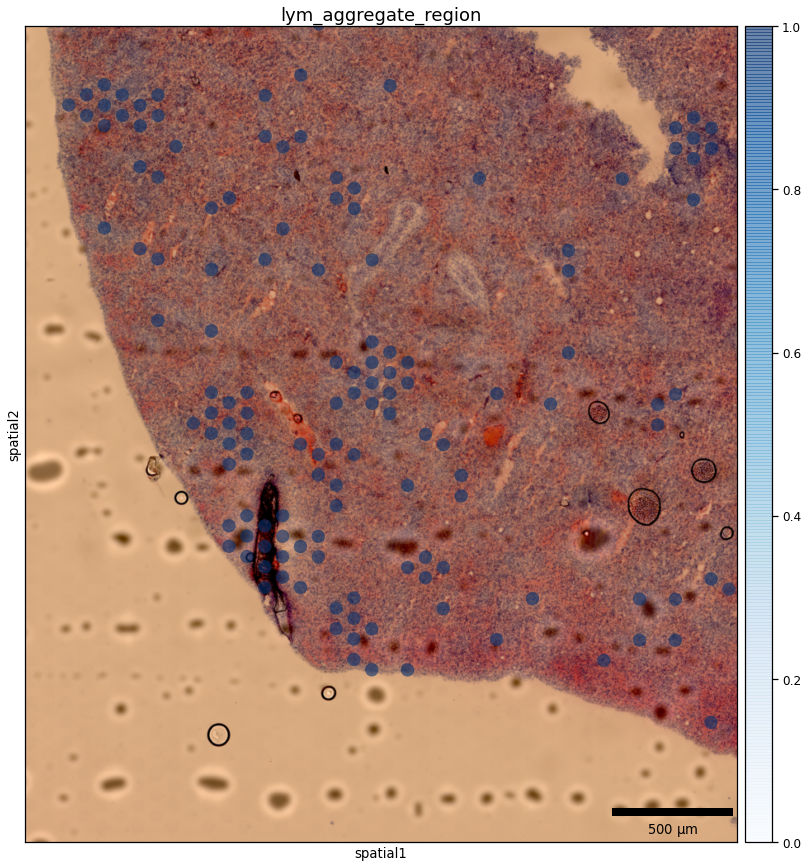

In [297]:
plt.rcParams['figure.figsize'] = [15,15]
org = 'SP'
s = 'WSSS_F_IMMsp9838715'
lib_id = [x for x in c2l_results[org].uns['spatial'].keys() if s in x][0]
fig, ax = plt.subplots()
quant = np.quantile(c2l_results[org][c2l_results[org].obs['sample'] == s].obs["B_progenitors"], 0.9)
pix_size = get_pixel_size_visium(c2l_results[org], lib_id, img='hires')
keep_obs = c2l_results[org][c2l_results[org].obs['sample'] == s].obs["lym_aggregate_region"] == 1
sc.pl.spatial(c2l_results[org][c2l_results[org].obs['sample'] == s][keep_obs], 
              color='lym_aggregate_region', img_key='hires', cmap='Blues',
             library_id=lib_id, size=1, vmin=0,alpha=0.6,
             crop_coord=[2000,5535,3194,7245], show=False, ax=ax)
# keep_obs = c2l_results[org][c2l_results[org].obs['sample'] == s].obs["B_progenitors"] >= quant
# sc.pl.spatial(c2l_results[org][c2l_results[org].obs['sample'] == s][keep_obs], 
#               color='B_progenitors', img_key='hires', cmap='viridis',
#              library_id=lib_id, size=1, vmax=quant, vmin=0,alpha=0.5,
#              crop_coord=[2000,5535,3194,7245], show=False, ax=ax)
scalebar = ScaleBar(pix_size, "um", length_fraction=0.25, frameon=False, location='lower right')
ax.add_artist(scalebar)

In [279]:
## Define factors for extra-thymic lymphoid tissues
lym_aggregates_factor = 'fact_3'

samples = vis_sample_metadata.index[vis_sample_metadata.Organ=="TH"]
c2l_results["TH"].obs['lym_aggregate_region'] = 0
for s in samples:
    keep_obs = c2l_results["TH"].obs['sample'] == s
    quant = np.quantile(c2l_results["TH"].obs.loc[keep_obs, lym_aggregates_factor], 0.95)
    c2l_results["TH"].obs.loc[keep_obs, 'lym_aggregate_region'] = (c2l_results["TH"].obs.loc[keep_obs, lym_aggregates_factor] > quant).astype('int')

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'Organ' as categorical


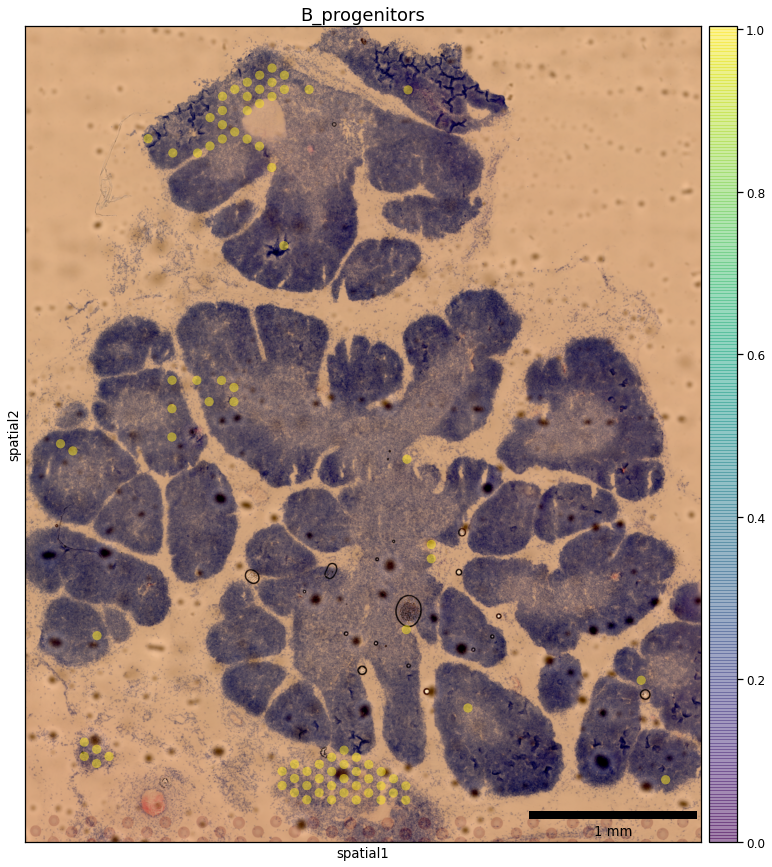

In [285]:
plt.rcParams['figure.figsize'] = [15,15]
org = 'TH'
s = 'WSSS_F_IMMsp9838716'
lib_id = [x for x in c2l_results[org].uns['spatial'].keys() if s in x][0]
fig, ax = plt.subplots()
quant = np.quantile(c2l_results[org][c2l_results[org].obs['sample'] == s].obs["B_progenitors"], 0.95)
pix_size = get_pixel_size_visium(c2l_results[org], lib_id, img='hires')
# keep_obs = c2l_results[org][c2l_results[org].obs['sample'] == s].obs["lym_aggregate_region"] == 1
# sc.pl.spatial(c2l_results[org][c2l_results[org].obs['sample'] == s][keep_obs], 
#               color='lym_aggregate_region', img_key='hires', cmap='Blues',
#              library_id=lib_id, size=1, vmin=0,alpha=1,
# #              crop_coord=[3000,5535,5194,7545], 
#               show=False, ax=ax)
keep_obs = c2l_results[org][c2l_results[org].obs['sample'] == s].obs["B_progenitors"] >= quant
sc.pl.spatial(c2l_results[org][c2l_results[org].obs['sample'] == s][keep_obs], 
              color='B_progenitors', img_key='hires', cmap='viridis',
             library_id=lib_id, size=1, vmin=0,alpha=0.5,vmax=quant,
#              crop_coord=[3000,5535,5194,7545], 
              show=False, ax=ax)
scalebar = ScaleBar(pix_size, "um", length_fraction=0.25, frameon=False, location='lower right')
ax.add_artist(scalebar)

Trying to set attribute `.obs` of view, copying.
... storing 'Organ' as categorical


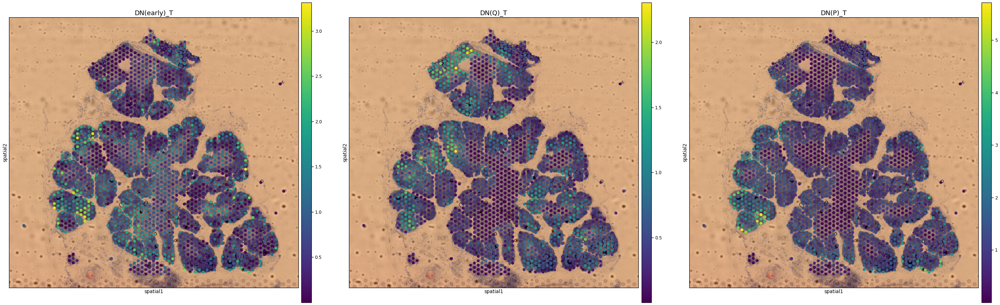

In [294]:
sc.pl.spatial(c2l_results[org][c2l_results[org].obs['sample'] == s], 
              color=['DN(early)_T','DN(Q)_T','DN(P)_T'], img_key='hires', cmap='viridis',
             library_id=lib_id)

<AxesSubplot:xlabel='age', ylabel='frac_cells'>

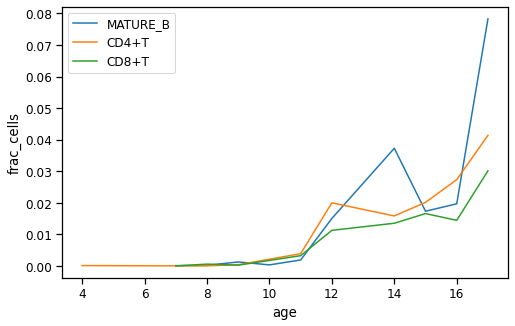

In [336]:
plt.rcParams['figure.figsize'] = [8,5]
df = anno_obs[['age', 'anno_lvl_2_final_clean']].groupby(['age', 'anno_lvl_2_final_clean']).size().reset_index()
df.columns = ['age', 'anno_lvl_2_final_clean', 'n_cells']
tot_cells = df.groupby("age").sum('n_cells').reset_index()
tot_cells.columns = ['age', 'tot_cells']
df = pd.merge(df, tot_cells)
df['frac_cells'] = df['n_cells'] /df['tot_cells'] 
sns.lineplot(data=df[df.anno_lvl_2_final_clean == 'MATURE_B'], x='age', y='frac_cells', label='MATURE_B')
sns.lineplot(data=df[df.anno_lvl_2_final_clean == 'CD4+T'], x='age', y='frac_cells', label='CD4+T')
sns.lineplot(data=df[df.anno_lvl_2_final_clean == 'CD8+T'], x='age', y='frac_cells', label="CD8+T")

#### Check overlap with lymphoid aggregates in spleen

In [ ]:
## Define factors for lymphoid aggregates
lym_aggregates_factor = 'fact_3'

samples = vis_sample_metadata.index[vis_sample_metadata.Organ=="SP"]
c2l_results["SP"].obs['lym_aggregate_region'] = 0
for s in samples:
    keep_obs = c2l_results["SP"].obs['sample'] == s
    quant = np.quantile(c2l_results["SP"].obs.loc[keep_obs, lym_aggregates_factor], 0.9)
    c2l_results["SP"].obs.loc[keep_obs, 'lym_aggregate_region'] = (c2l_results["SP"].obs.loc[keep_obs, lym_aggregates_factor] > quant).astype('int')

... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical


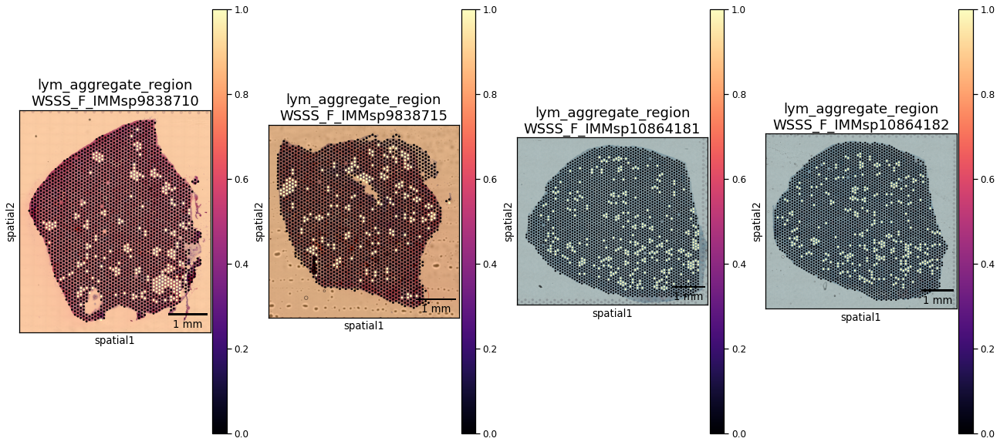

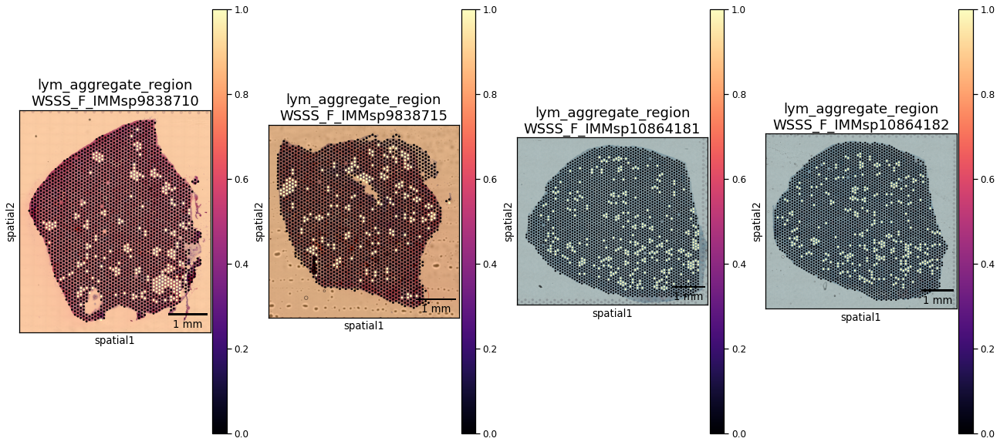

In [202]:
plot_spatial_per_cell_type(c2l_results["SP"], cell_type="lym_aggregate_region", 
                           samples=vis_sample_metadata.index[vis_sample_metadata.Organ=="SP"], ncol=len(samples))

In [190]:
## Define factors for lymphoid aggregates
samples = vis_sample_metadata.index[vis_sample_metadata.Organ=="SP"]
c2l_results["SP"].obs['B_prog_region'] = 0
for s in samples:
    keep_obs = c2l_results["SP"].obs['sample'] == s
    quant = np.quantile(c2l_results["SP"].obs.loc[keep_obs, 'B_progenitors'], 0.9)
    c2l_results["SP"].obs.loc[keep_obs, 'B_prog_region'] = (c2l_results["SP"].obs.loc[keep_obs, "B_progenitors"] > quant).astype('int')

... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical


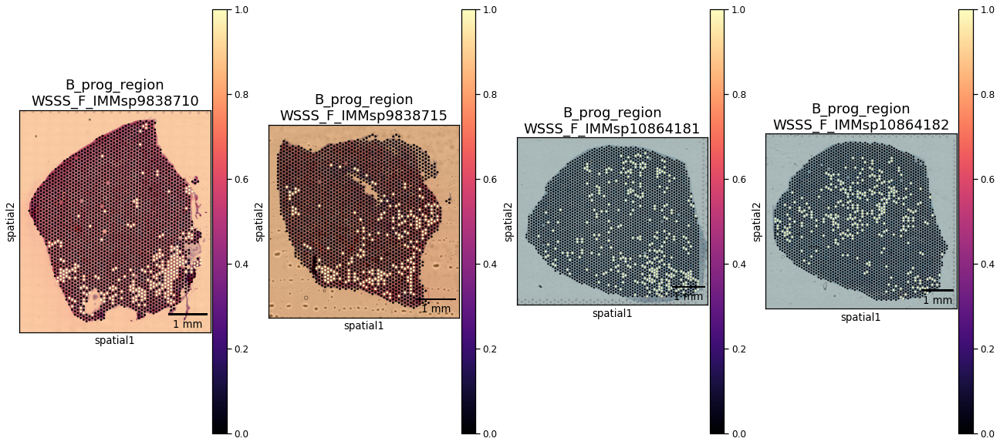

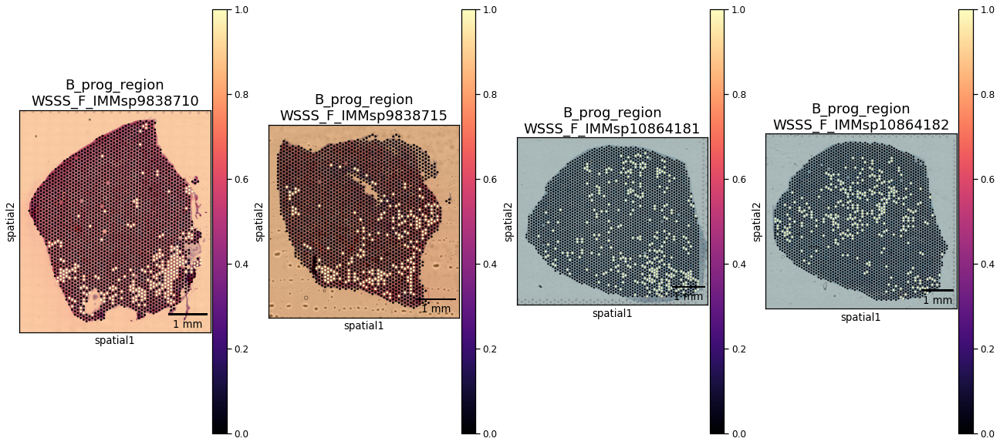

In [191]:
plot_spatial_per_cell_type(c2l_results["SP"], cell_type="B_prog_region", 
                           samples=vis_sample_metadata.index[vis_sample_metadata.Organ=="SP"], ncol=len(samples))

In [192]:
## Define spatial neighbourhood graph
sq.gr.spatial_neighbors(c2l_results["SP"], n_rings=1, coord_type="grid", n_neighs=6)

In [193]:
## Distance to ROI
def distance2ROI(adata_vis, ROI_col):
    from scipy.spatial import distance
    adata_vis.obsp['spatial_distances_all'] = distance.squareform(distance.pdist(adata_vis.obs[['array_row','array_col']]))

    in_roi = adata_vis.obs[ROI_col] == 1
    out_roi = adata_vis.obs[ROI_col] == 0

    ## Find distance to ROI
    adata_vis.obs['mean_dist2ROI'] = adata_vis.obsp['spatial_distances_all'][:,in_roi].mean(1).round()
    adata_vis.obs['min_dist2ROI'] = adata_vis.obsp['spatial_distances_all'][:,in_roi].min(1).round()
    return(adata_vis)


In [203]:
c2l_results["SP"] = distance2ROI(c2l_results["SP"], 'lym_aggregate_region')

... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical
... storing 'Organ' as categorical


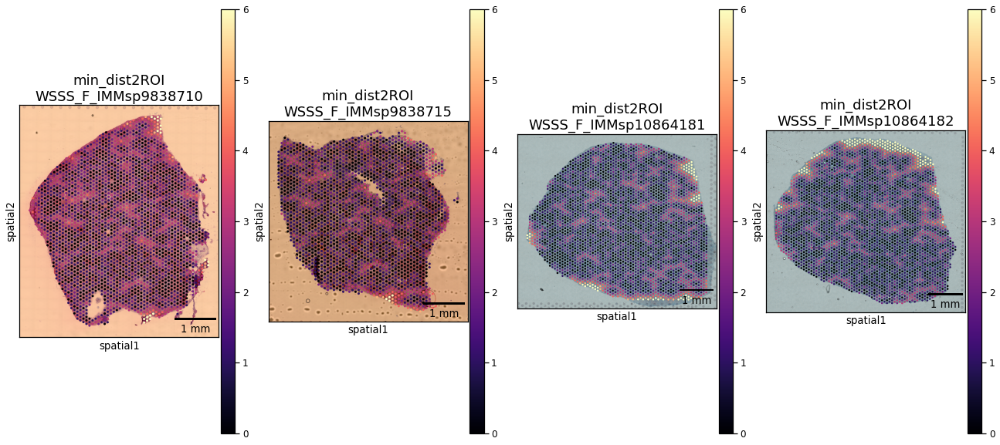

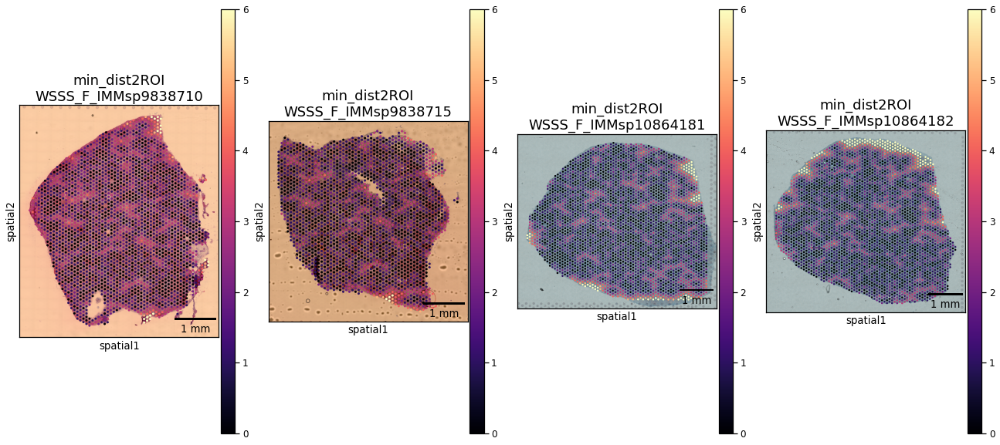

In [204]:
plot_spatial_per_cell_type(c2l_results["SP"], cell_type="min_dist2ROI", 
                           samples=vis_sample_metadata.index[vis_sample_metadata.Organ=="SP"], ncol=len(samples))

In [205]:
df = c2l_results["SP"].obs[['min_dist2ROI', "B_progenitors", "B_prog_region"]]
df.loc[df['B_progenitors'] > df.B_progenitors.quantile(0.992), 'B_progenitors'] = df.B_progenitors.quantile(0.992)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


In [206]:
%%R -i df
quants <- quantile(df$B_progenitors, seq(0,1,by=0.25))

In [220]:
%%R
df <- mutate(df, min_dist2ROI=ifelse(min_dist2ROI >= 6, 6, min_dist2ROI))

## Permutation test
n_spots <- sum(df$B_prog_region)
n_perm = 10000
pvals <- c()
means <- c()
for (i in 1:n_perm) {
    null_ixs <- sample(1:nrow(df), n_spots)
    df[,paste0('perm_', i)] <- 0
    df[null_ixs,paste0('perm_', i)] <- 1
#     ks_stat <- ks.test(df$min_dist2ROI[null_ixs], df$min_dist2ROI[df$B_prog_region==1])
    mean_dist <- mean(df$min_dist2ROI[null_ixs])
    means <- c(means, mean_dist)
#     pval <-ks_stat$p.value
#     pvals <- c(pvals, pval)
    }
# ks_stat <- ks.test(null_dist, df$min_dist2ROI[df$B_prog_region==1])

In [252]:
%%R 
long_df <- pivot_longer(df, cols= - colnames(df)[1:3], names_to='permutations') %>% 
 filter(value==1)
    

In [260]:
%%R
pl_top <- long_df %>%
    group_by(permutations) %>%
    mutate(n_all=n()) %>%
    ungroup() %>%
    group_by(permutations, min_dist2ROI) %>%
    summarise(n=n()) %>%
    mutate(frac = n/nrow(df)) %>%
    ggplot(aes(as.factor(min_dist2ROI), frac)) +
    geom_line(aes(group=permutations), alpha=0.1) +
    theme_bw(base_size=18) 

`summarise()` has grouped output by 'permutations'. You can override using the `.groups` argument.


In [264]:
%%R
mean_dist_true <- mean(df$min_dist2ROI[df$B_prog_region==1])
perm_pval <- sum( mean_dist_true > means )/length( means )
perm_pval

[1] 0.0097


`summarise()` has grouped output by 'B_prog_region'. You can override using the `.groups` argument.


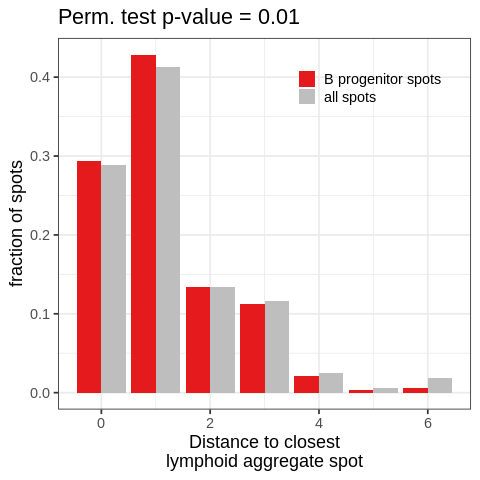

In [265]:
%%R -i figdir
df %>%
select(min_dist2ROI, B_prog_region) %>%
group_by(B_prog_region) %>%
mutate(n_all=n()) %>%
ungroup() %>%
group_by(B_prog_region, min_dist2ROI) %>%
summarise(n=n(), n_all=first(n_all)) %>%
ungroup() %>%
mutate(frac=n/n_all) %>%
mutate(B_prog_region=factor(as.character(B_prog_region), levels=c("1", '0'))) %>%
ggplot(aes(min_dist2ROI, frac, fill=B_prog_region)) +
geom_col(position='dodge') +
# geom_line() +
scale_fill_manual(name='', 
                  values=c(RColorBrewer::brewer.pal(2, "Set1")[1], 'grey'), 
                  labels=c("1"='B progenitor spots', "0"='all spots')) +
theme_bw(base_size=18) +
ylab('fraction of spots') +
xlab("Distance to closest\nlymphoid aggregate spot") +
theme(legend.position=c(0.95,0.9), legend.justification=c(hjust=1, vjust=0.5),
      legend.background=element_blank()
     ) +
# facet_grid(.~B_prog_region) +
ggtitle(paste0("Perm. test p-value = ", round(perm_pval, 3)))  +
ggsave(paste0(figdir, 'distance_2_SP_lymph_aggregates.pdf'), height=7, width=8) 
# geom_histogram(position='identity', bins=10) +
# geom_density(data=. %>% filter(name=='B_prog_region'), color='red', position='identity', adjust = 3) 
# facet_grid(B_prog_region~.)

In [586]:
# %%R
# df %>%
# mutate(prog_abundance=cut(B_progenitors, seq(0,5, by=1), include.lowest=TRUE)) %>%
# mutate(min_dist2ROI=factor(ifelse(min_dist2ROI >= 6, '6+', as.character(min_dist2ROI)))) %>%
# # group_by(prog_abundance, overlapping_lymph) %>%
# # summarise(n=n()) %>%
# ggplot(aes(prog_abundance, fill=min_dist2ROI)) +
# geom_bar(position='fill') +
# scale_fill_viridis_d(option='magma', direction=-1, name='distance 2 closest\nlymphoid aggregate') +
# theme_bw(base_size=18) +
# ylab('fraction') +
# xlab("B progenitor abundance")

## Prep h5ad files for data sharing

In [270]:
outdir = '/nfs/team205/ed6/data/Fetal_immune/cellxgene_h5ad_files/Visium_data/'
if not os.path.exists(outdir):
    os.mkdir(outdir)
    
keep_obs_cols = ['in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts',
       'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts',
       'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes',
       'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac',
       'img_id', 'EXP_id', 'Organ', 'Fetal_id', 'SN', 'Visium_Area_id',
       'Age_PCW', 'Digestion time', 'paths', 'sample_id', '_scvi_batch',
       '_scvi_labels', '_indices', 'total_cell_abundance']

for org in ['SP', 'TH', "LI"]:
    c2l_results[org].obs = c2l_results[org].obs[keep_obs_cols]
    del c2l_results[org].obsm['mt']
    c2l_results[org].var = c2l_results[org].var[['feature_types', 'genome', 'SYMBOL', 'mt']].copy()
    c2l_results[org].uns['NMF_celltype_fractions'] = nmf_fractions_dict[org]
    c2l_results[org].write_h5ad(outdir + 'Visium10X_data_{o}.h5ad'.format(o=org))

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1233: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[key] = c
... storing 'Organ' as categorical
... storing 'Organ' as categorical


KeyError: 'mt'